# Business Question: Based on the total amount Netflix subscribers contribute, what will the predicted revenue average be?


# Data Question: What difference would increasing the percentage of ‘Premium’ subscribers have on the total revenue average?


In [3]:
import numpy as np
import pandas as pd
import seaborn as sns
import patsy

from sklearn.model_selection import train_test_split, GridSearchCV, cross_val_score, cross_val_predict, cross_validate, KFold
from sklearn.linear_model import LogisticRegression, LogisticRegressionCV
from sklearn.metrics import make_scorer, f1_score, recall_score, precision_score
from sklearn.compose import ColumnTransformer
from sklearn.preprocessing import FunctionTransformer
from sklearn.pipeline import Pipeline
from sklearn.impute import SimpleImputer
from sklearn.preprocessing import OneHotEncoder, StandardScaler
from sklearn.linear_model import LinearRegression
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import AdaBoostRegressor
from lightgbm import LGBMRegressor
from sklearn.metrics import mean_absolute_error, mean_squared_error, r2_score
from sklearn.tree import DecisionTreeRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.linear_model import Ridge, Lasso
from xgboost import XGBRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.svm import SVC, SVR
from sklearn.preprocessing import LabelEncoder
from dython.nominal import associations
from datetime import datetime


import matplotlib.pyplot as plt
plt.style.use('fivethirtyeight')

%matplotlib inline
%config InlineBackend.figure_format = 'retina'
import warnings
warnings.filterwarnings('ignore')

In [4]:
netflix_csv = r"C:\Users\marve\Downloads\Netflix Userbase.csv"

In [5]:
df = pd.read_csv(netflix_csv)
df.drop(['User ID', 'Plan Duration',], axis=1, inplace=True)
df.head()

,Subscription Type,Monthly Revenue,Join Date,Last Payment Date,Country,Age,Gender,Device
0,Basic,10,15/01/2022,10/06/2023,United States,28,Male,Smartphone
1,Premium,15,5/09/2021,22/06/2023,Canada,35,Female,Tablet
2,Standard,12,28/02/2023,27/06/2023,United Kingdom,42,Male,Smart TV
3,Standard,12,10/07/2022,26/06/2023,Australia,51,Female,Laptop
4,Basic,10,1/05/2023,28/06/2023,Germany,33,Male,Smartphone


In [6]:
subscription_revenue_map = {
    'Basic': 9,
    'Standard': 13,
    'Premium': 18
}

df['Subscription Revenue'] = df['Subscription Type'].map(subscription_revenue_map)

In [7]:
df['Join Date'] = pd.to_datetime(df['Join Date'], format='%d/%m/%Y')

df['Month_Year'] = df['Join Date'].dt.to_period('M')

print(df)

     Subscription Type  Monthly Revenue  Join Date Last Payment Date  \
0                Basic               10 2022-01-15        10/06/2023   
1              Premium               15 2021-09-05        22/06/2023   
2             Standard               12 2023-02-28        27/06/2023   
3             Standard               12 2022-07-10        26/06/2023   
4                Basic               10 2023-05-01        28/06/2023   
...                ...              ...        ...               ...   
2495           Premium               14 2022-07-25        12/07/2023   
2496             Basic               15 2022-08-04        14/07/2023   
2497          Standard               12 2022-08-09        15/07/2023   
2498          Standard               13 2022-08-12        12/07/2023   
2499             Basic               15 2022-08-13        12/07/2023   

             Country  Age  Gender      Device  Subscription Revenue Month_Year  
0      United States   28    Male  Smartphone         

In [8]:
df['Join Year'] = df['Join Date'].dt.year
df['Join Month'] = df['Join Date'].dt.month
df['Day_of_Week'] = df['Join Date'].dt.day_name()

df.head(6)

,Subscription Type,Monthly Revenue,Join Date,Last Payment Date,Country,Age,Gender,Device,Subscription Revenue,Month_Year,Join Year,Join Month,Day_of_Week
0,Basic,10,2022-01-15,10/06/2023,United States,28,Male,Smartphone,9,2022-01,2022,1,Saturday
1,Premium,15,2021-09-05,22/06/2023,Canada,35,Female,Tablet,18,2021-09,2021,9,Sunday
2,Standard,12,2023-02-28,27/06/2023,United Kingdom,42,Male,Smart TV,13,2023-02,2023,2,Tuesday
3,Standard,12,2022-07-10,26/06/2023,Australia,51,Female,Laptop,13,2022-07,2022,7,Sunday
4,Basic,10,2023-05-01,28/06/2023,Germany,33,Male,Smartphone,9,2023-05,2023,5,Monday
5,Premium,15,2022-03-18,27/06/2023,France,29,Female,Smart TV,18,2022-03,2022,3,Friday


In [9]:
missing_values = df.isnull().sum()
print(missing_values)

Subscription Type       0
Monthly Revenue         0
Join Date               0
Last Payment Date       0
Country                 0
Age                     0
Gender                  0
Device                  0
Subscription Revenue    0
Month_Year              0
Join Year               0
Join Month              0
Day_of_Week             0
dtype: int64


In [10]:
df['Subscription Type'] = df['Subscription Type'].astype('category')
df['Country'] = df['Country'].astype('category')
df['Gender'] = df['Gender'].astype('category')
df['Device'] = df['Device'].astype('category')

In [11]:
df['Last Payment Date'] = pd.to_datetime(df['Last Payment Date'], format='%d/%m/%Y')

In [12]:
df['Last Pay Year'] = df['Last Payment Date'].dt.year
df['Last Pay Month'] = df['Last Payment Date'].dt.month
df['Last Pay Day'] = df['Last Payment Date'].dt.day_name()

df.head(6)

,Subscription Type,Monthly Revenue,Join Date,Last Payment Date,Country,Age,Gender,Device,Subscription Revenue,Month_Year,Join Year,Join Month,Day_of_Week,Last Pay Year,Last Pay Month,Last Pay Day
0,Basic,10,2022-01-15,2023-06-10,United States,28,Male,Smartphone,9,2022-01,2022,1,Saturday,2023,6,Saturday
1,Premium,15,2021-09-05,2023-06-22,Canada,35,Female,Tablet,18,2021-09,2021,9,Sunday,2023,6,Thursday
2,Standard,12,2023-02-28,2023-06-27,United Kingdom,42,Male,Smart TV,13,2023-02,2023,2,Tuesday,2023,6,Tuesday
3,Standard,12,2022-07-10,2023-06-26,Australia,51,Female,Laptop,13,2022-07,2022,7,Sunday,2023,6,Monday
4,Basic,10,2023-05-01,2023-06-28,Germany,33,Male,Smartphone,9,2023-05,2023,5,Monday,2023,6,Wednesday
5,Premium,15,2022-03-18,2023-06-27,France,29,Female,Smart TV,18,2022-03,2022,3,Friday,2023,6,Tuesday


In [13]:
day_to_num = {
    'Monday': 0,
    'Tuesday': 1,
    'Wednesday': 2,
    'Thursday': 3,
    'Friday': 4,
    'Saturday': 5,
    'Sunday': 6
}

df['Join Day'] = df['Day_of_Week'].map(day_to_num)

In [14]:
days_to_num = {
    'Monday': 0,
    'Tuesday': 1,
    'Wednesday': 2,
    'Thursday': 3,
    'Friday': 4,
    'Saturday': 5,
    'Sunday': 6
}

df['Last Pay Day'] = df['Last Pay Day'].map(days_to_num)

In [15]:
df.drop(columns=['Day_of_Week'], inplace=True)
df.drop(columns=['Monthly Revenue'], inplace=True)

In [16]:
last_date_in_dataset = '07/15/2023'

current_date = pd.to_datetime(last_date_in_dataset)

df['Days Since Join'] = (current_date - df['Join Date']).dt.days
df['Days Since Last Pay'] = (current_date - df['Last Payment Date']).dt.days
df['Difference Days'] = df['Days Since Join'] - df['Days Since Last Pay']

df.head(6)

,Subscription Type,Join Date,Last Payment Date,Country,Age,Gender,Device,Subscription Revenue,Month_Year,Join Year,Join Month,Last Pay Year,Last Pay Month,Last Pay Day,Join Day,Days Since Join,Days Since Last Pay,Difference Days
0,Basic,2022-01-15,2023-06-10,United States,28,Male,Smartphone,9,2022-01,2022,1,2023,6,5,5,546,35,511
1,Premium,2021-09-05,2023-06-22,Canada,35,Female,Tablet,18,2021-09,2021,9,2023,6,3,6,678,23,655
2,Standard,2023-02-28,2023-06-27,United Kingdom,42,Male,Smart TV,13,2023-02,2023,2,2023,6,1,1,137,18,119
3,Standard,2022-07-10,2023-06-26,Australia,51,Female,Laptop,13,2022-07,2022,7,2023,6,0,6,370,19,351
4,Basic,2023-05-01,2023-06-28,Germany,33,Male,Smartphone,9,2023-05,2023,5,2023,6,2,0,75,17,58
5,Premium,2022-03-18,2023-06-27,France,29,Female,Smart TV,18,2022-03,2022,3,2023,6,1,4,484,18,466


In [17]:
df['Total Payments'] = (df['Days Since Join'] // 30)

df['Pay Frequency'] = df['Days Since Join'] / df['Total Payments']

df['Pay Frequency'] = df['Pay Frequency'].round(2)

In [18]:
df.rename(columns=lambda x: x.replace(' ', '_'), inplace=True)

In [19]:
df['Months_Since_Join'] = ((df['Last_Payment_Date'] - df['Join_Date']) / np.timedelta64(1, 'M')).astype(int)

print(df[['Join_Date', 'Last_Payment_Date', 'Months_Since_Join']].head())

   Join_Date Last_Payment_Date  Months_Since_Join
0 2022-01-15        2023-06-10                 16
1 2021-09-05        2023-06-22                 21
2 2023-02-28        2023-06-27                  3
3 2022-07-10        2023-06-26                 11
4 2023-05-01        2023-06-28                  1


In [20]:
df['Total_Revenue'] = df['Subscription_Revenue'] * df['Total_Payments']

print(df[['Subscription_Revenue', 'Total_Payments', 'Total_Revenue']].head())

   Subscription_Revenue  Total_Payments  Total_Revenue
0                     9              18            162
1                    18              22            396
2                    13               4             52
3                    13              12            156
4                     9               2             18


In [21]:
df['Ave_Monthly_Rev'] = df['Total_Revenue'] / df['Months_Since_Join']

print(df[['Total_Revenue', 'Months_Since_Join', 'Ave_Monthly_Rev']].head())

   Total_Revenue  Months_Since_Join  Ave_Monthly_Rev
0            162                 16        10.125000
1            396                 21        18.857143
2             52                  3        17.333333
3            156                 11        14.181818
4             18                  1        18.000000


In [22]:
numeric_columns = df.select_dtypes(include=['int64', 'int32', 'float64']).columns

Q1 = df[numeric_columns].quantile(0.25)
Q3 = df[numeric_columns].quantile(0.75)

IQR = Q3 - Q1

lower_bound = Q1 - 1.5 * IQR
upper_bound = Q3 + 1.5 * IQR

outliers = ((df[numeric_columns] < lower_bound) | (df[numeric_columns] > upper_bound)).sum()

print("Number of outliers:")
print(outliers)

Number of outliers:
Age                      0
Subscription_Revenue     0
Join_Year               52
Join_Month              32
Last_Pay_Year            0
Last_Pay_Month           0
Last_Pay_Day             0
Join_Day                 0
Days_Since_Join         44
Days_Since_Last_Pay      1
Difference_Days         44
Total_Payments          45
Pay_Frequency           17
Months_Since_Join       45
Total_Revenue           21
Ave_Monthly_Rev          4
dtype: int64


In [23]:
outlier_mask = ((df[numeric_columns] < lower_bound) | (df[numeric_columns] > upper_bound)).any(axis=1)

clean_df = df[~outlier_mask]

print(f"Original DataFrame shape: {df.shape}")
print(f"Cleaned DataFrame shape: {clean_df.shape}")

Original DataFrame shape: (2500, 23)
Cleaned DataFrame shape: (2423, 23)


In [24]:
nan_counts_per_column = clean_df.isnull().sum()

total_nan_count = clean_df.isnull().sum().sum()

print("NaN counts per column:")
print(nan_counts_per_column)
print("\nTotal number of NaN values in the dataset:", total_nan_count)

NaN counts per column:
Subscription_Type       0
Join_Date               0
Last_Payment_Date       0
Country                 0
Age                     0
Gender                  0
Device                  0
Subscription_Revenue    0
Month_Year              0
Join_Year               0
Join_Month              0
Last_Pay_Year           0
Last_Pay_Month          0
Last_Pay_Day            0
Join_Day                0
Days_Since_Join         0
Days_Since_Last_Pay     0
Difference_Days         0
Total_Payments          0
Pay_Frequency           0
Months_Since_Join       0
Total_Revenue           0
Ave_Monthly_Rev         0
dtype: int64

Total number of NaN values in the dataset: 0


In [25]:
combined_total_revenue = clean_df['Total_Revenue'].sum()

print(f"The combined total of Total_Revenue is: {combined_total_revenue}")

The combined total of Total_Revenue is: 316929


In [26]:
subscription_revenue_counts = clean_df['Subscription_Revenue'].value_counts()

print("Counts of each Subscription_Revenue value:")
print(subscription_revenue_counts)

Counts of each Subscription_Revenue value:
Subscription_Revenue
9     974
13    743
18    706
Name: count, dtype: int64


# EDA

In [27]:
clean_df

,Subscription_Type,Join_Date,Last_Payment_Date,Country,Age,Gender,Device,Subscription_Revenue,Month_Year,Join_Year,...,Last_Pay_Day,Join_Day,Days_Since_Join,Days_Since_Last_Pay,Difference_Days,Total_Payments,Pay_Frequency,Months_Since_Join,Total_Revenue,Ave_Monthly_Rev
3,Standard,2022-07-10,2023-06-26,Australia,51,Female,Laptop,13,2022-07,2022,...,0,6,370,19,351,12,30.83,11,156,14.181818
8,Standard,2022-10-20,2023-06-23,Spain,37,Male,Smartphone,13,2022-10,2022,...,4,3,268,22,246,8,33.50,7,104,14.857143
10,Basic,2022-05-16,2023-06-22,United States,31,Female,Smartphone,9,2022-05,2022,...,3,0,425,23,402,14,30.36,12,126,10.500000
13,Basic,2022-08-01,2023-06-26,Australia,27,Male,Smartphone,9,2022-08,2022,...,0,0,348,19,329,11,31.64,10,99,9.900000
21,Basic,2022-07-22,2023-06-28,Canada,34,Male,Smartphone,9,2022-07,2022,...,2,4,358,17,341,11,32.55,11,99,9.000000
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2495,Premium,2022-07-25,2023-07-12,Spain,28,Female,Smart TV,18,2022-07,2022,...,2,0,355,3,352,11,32.27,11,198,18.000000
2496,Basic,2022-08-04,2023-07-14,Spain,33,Female,Smart TV,9,2022-08,2022,...,4,3,345,1,344,11,31.36,11,99,9.000000
2497,Standard,2022-08-09,2023-07-15,United States,38,Male,Laptop,13,2022-08,2022,...,5,1,340,0,340,11,30.91,10,143,14.300000
2498,Standard,2022-08-12,2023-07-12,Canada,48,Female,Tablet,13,2022-08,2022,...,2,4,337,3,334,11,30.64,10,143,14.300000


In [28]:
average_total_revenue = clean_df['Total_Revenue'].mean()

print(f'The average total revenue is: {average_total_revenue:.5f}')

The average total revenue is: 130.80025


In [29]:
clean_df.shape

(2423, 23)

In [30]:
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2423 entries, 3 to 2499
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Subscription_Type     2423 non-null   category      
 1   Join_Date             2423 non-null   datetime64[ns]
 2   Last_Payment_Date     2423 non-null   datetime64[ns]
 3   Country               2423 non-null   category      
 4   Age                   2423 non-null   int64         
 5   Gender                2423 non-null   category      
 6   Device                2423 non-null   category      
 7   Subscription_Revenue  2423 non-null   int64         
 8   Month_Year            2423 non-null   period[M]     
 9   Join_Year             2423 non-null   int32         
 10  Join_Month            2423 non-null   int32         
 11  Last_Pay_Year         2423 non-null   int32         
 12  Last_Pay_Month        2423 non-null   int32         
 13  Last_Pay_Day          2

In [31]:
clean_df.describe()

,Join_Date,Last_Payment_Date,Age,Subscription_Revenue,Join_Year,Join_Month,Last_Pay_Year,Last_Pay_Month,Last_Pay_Day,Join_Day,Days_Since_Join,Days_Since_Last_Pay,Difference_Days,Total_Payments,Pay_Frequency,Months_Since_Join,Total_Revenue,Ave_Monthly_Rev
count,2423,2423,2423.000000,2423.000000,2423.0,2423.000000,2423.0,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000,2423.000000
mean,2022-08-29 03:03:02.748658688,2023-07-03 15:31:52.174989824,38.836566,12.848948,2022.0,8.449030,2023.0,6.674371,2.839868,3.079653,319.872885,11.352868,308.520017,10.190260,31.449851,9.439950,130.800248,13.905214
min,2022-03-04 00:00:00,2023-06-22 00:00:00,27.000000,9.000000,2022.0,3.000000,2023.0,6.000000,0.000000,0.000000,199.000000,0.000000,177.000000,6.000000,30.000000,5.000000,54.000000,9.000000
25%,2022-07-16 00:00:00,2023-06-29 00:00:00,32.000000,9.000000,2022.0,7.000000,2023.0,6.000000,1.000000,1.000000,272.000000,7.000000,263.000000,9.000000,30.670000,8.000000,99.000000,9.900000
50%,2022-08-31 00:00:00,2023-07-04 00:00:00,39.000000,13.000000,2022.0,8.000000,2023.0,7.000000,3.000000,3.000000,318.000000,11.000000,307.000000,10.000000,31.400000,9.000000,117.000000,14.181818
75%,2022-10-16 00:00:00,2023-07-08 00:00:00,45.000000,18.000000,2022.0,10.000000,2023.0,7.000000,5.000000,5.000000,364.000000,16.000000,355.000000,12.000000,32.090000,11.000000,156.000000,18.000000
max,2022-12-28 00:00:00,2023-07-15 00:00:00,51.000000,18.000000,2022.0,12.000000,2023.0,7.000000,6.000000,6.000000,498.000000,23.000000,480.000000,16.000000,34.140000,15.000000,252.000000,21.600000
std,NaN,NaN,7.191474,3.701201,0.0,1.744811,0.0,0.468706,2.035591,1.995415,51.931173,5.247991,51.223562,1.738866,0.921327,1.684315,43.738022,4.049682



Reordered DataFrame:
                   Total_Revenue  Percentage_of_Total
Subscription_Type                                    
Basic                       8766            28.156618
Standard                    9659            31.024957
Premium                    12708            40.818424


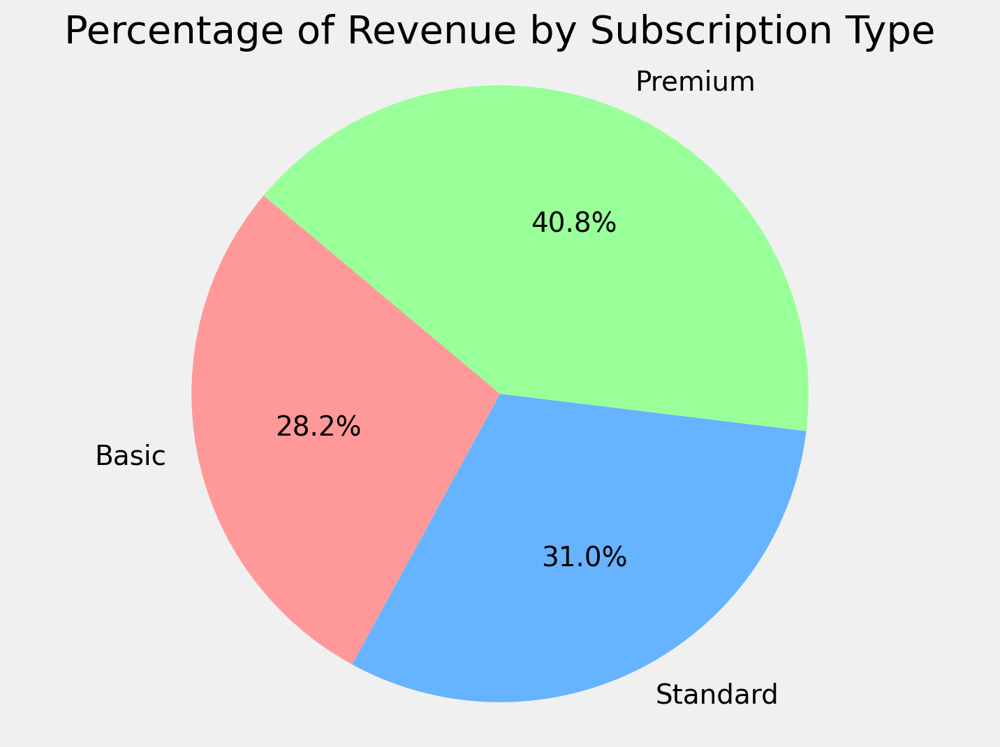

In [32]:
total_revenue = clean_df['Subscription_Revenue'].sum()
revenue_by_type = clean_df.groupby('Subscription_Type')['Subscription_Revenue'].sum()

percentage_by_type = (revenue_by_type / total_revenue) * 100

percentage_df = pd.DataFrame({
    'Total_Revenue': revenue_by_type,
    'Percentage_of_Total': percentage_by_type
})

ordered_types = ['Basic', 'Standard', 'Premium']
percentage_df = percentage_df.loc[ordered_types]

print("\nReordered DataFrame:")
print(percentage_df)

ordered_percentage = percentage_by_type.loc[ordered_types]

plt.figure(figsize=(8, 6))
plt.pie(ordered_percentage, labels=ordered_percentage.index, autopct='%1.1f%%', startangle=140,
        colors=['#ff9999', '#66b3ff', '#99ff99'])  # Colors ordered as per the new order
plt.title('Percentage of Revenue by Subscription Type')
plt.axis('equal')
plt.show()

  Subscription_Type  User_Count  Percentage
0             Basic         974   40.198102
1          Standard         743   30.664466
2           Premium         706   29.137433


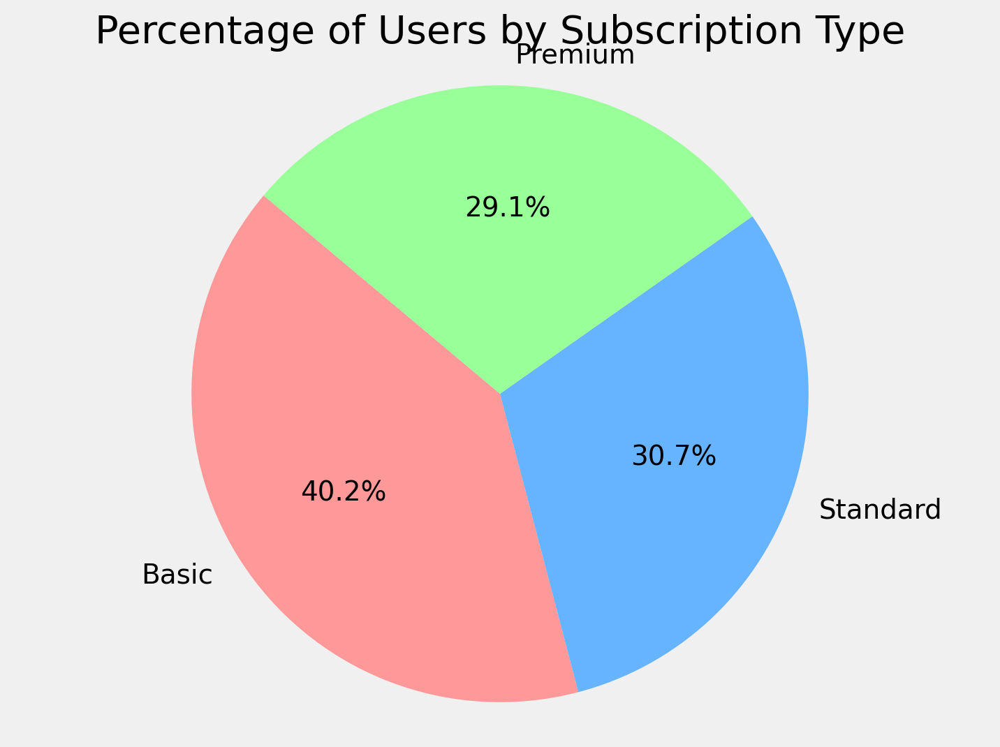

In [33]:
user_counts = clean_df.groupby('Subscription_Type').size().reset_index(name='User_Count')

# Calculate total users and percentage for each Subscription_Type
total_users = clean_df.shape[0]
user_counts['Percentage'] = (user_counts['User_Count'] / total_users) * 100

# Reorder user_counts DataFrame to swap 'Premium' with 'Standard'
user_counts = user_counts.set_index('Subscription_Type').loc[['Basic', 'Standard', 'Premium']].reset_index()

print(user_counts)

# Assign colors based on the new order of Subscription_Type
colors = ['#ff9999', '#66b3ff', '#99ff99']  # 'Basic' -> '#ff9999', 'Standard' -> '#66b3ff' (blue), 'Premium' -> '#99ff99' (green)

# Plot the pie chart
plt.figure(figsize=(8, 6))
plt.pie(user_counts['Percentage'], labels=user_counts['Subscription_Type'], autopct='%1.1f%%', startangle=140, colors=colors)
plt.title('Percentage of Users by Subscription Type')
plt.axis('equal')
plt.show()

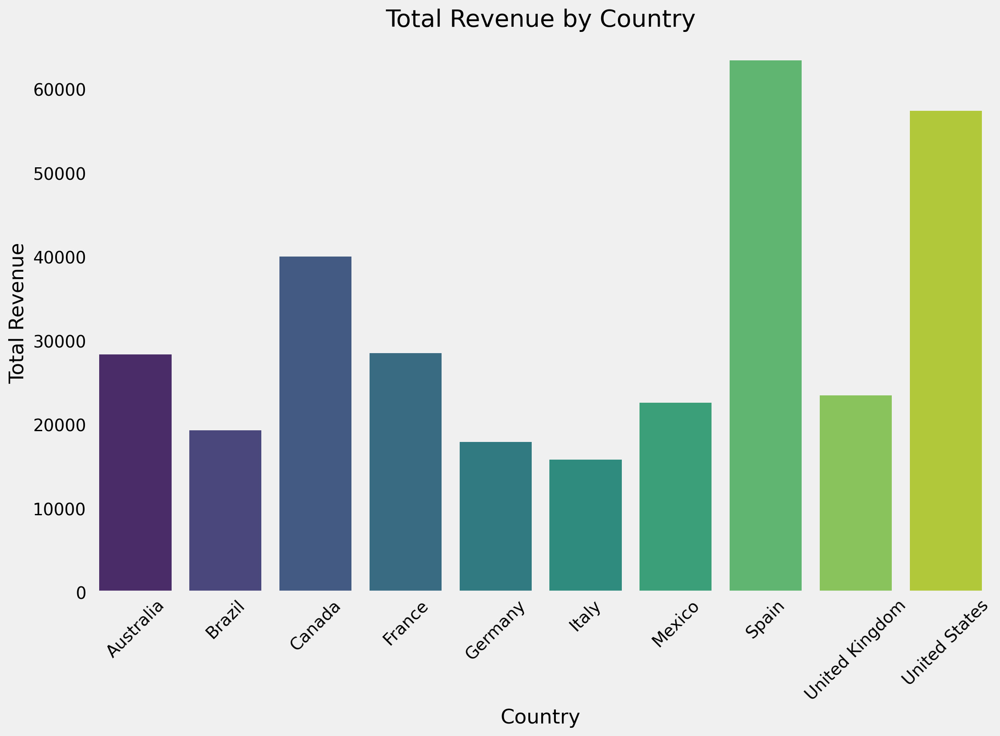

In [34]:
total_revenue_by_country = clean_df.groupby('Country')['Total_Revenue'].sum().reset_index()

total_revenue_by_country = total_revenue_by_country.sort_values(by='Total_Revenue', ascending=False)

plt.figure(figsize=(12, 8))
sns.barplot(data=total_revenue_by_country, x='Country', y='Total_Revenue', palette='viridis')
plt.title('Total Revenue by Country')
plt.xlabel('Country')
plt.ylabel('Total Revenue')
plt.xticks(rotation=45)
plt.grid(axis='y')
plt.show()

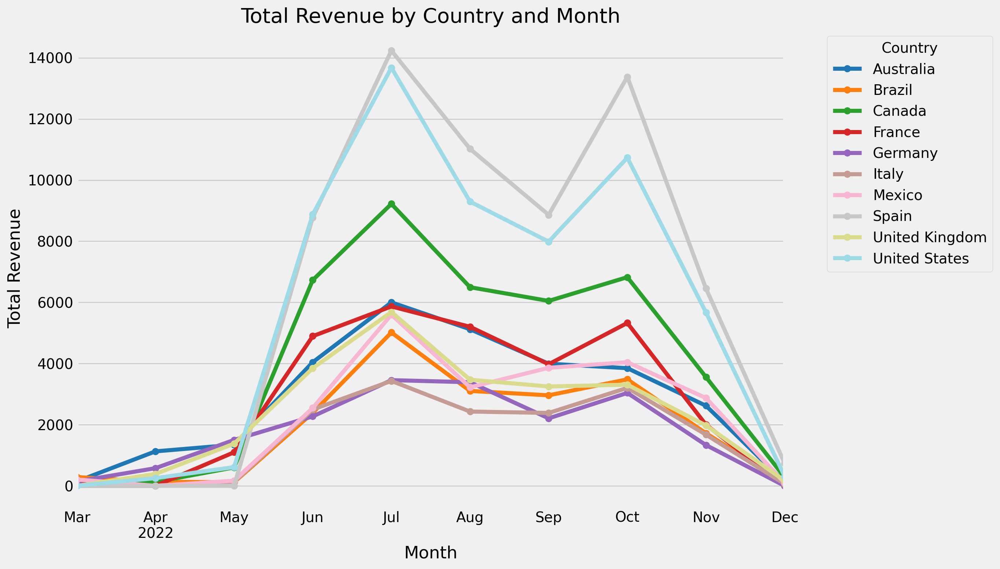

In [35]:
total_revenue_country_time = clean_df.groupby(['Month_Year', 'Country'])['Total_Revenue'].sum().unstack(fill_value=0)

plt.figure(figsize=(14, 8))
colors = plt.get_cmap('tab20').colors  
total_revenue_country_time.plot(kind='line', marker='o', colormap='tab20', ax=plt.gca())

plt.title('Total Revenue by Country and Month')
plt.xlabel('Month')
plt.ylabel('Total Revenue')
plt.grid(True)
plt.xticks(rotation=45)
plt.legend(title='Country', bbox_to_anchor=(1.05, 1), loc='upper left') 
plt.tight_layout()

plt.show()

In [36]:
subscription_counts = clean_df.groupby(['Country', 'Subscription_Type']).size().unstack(fill_value=0)

<Figure size 1600x800 with 0 Axes>

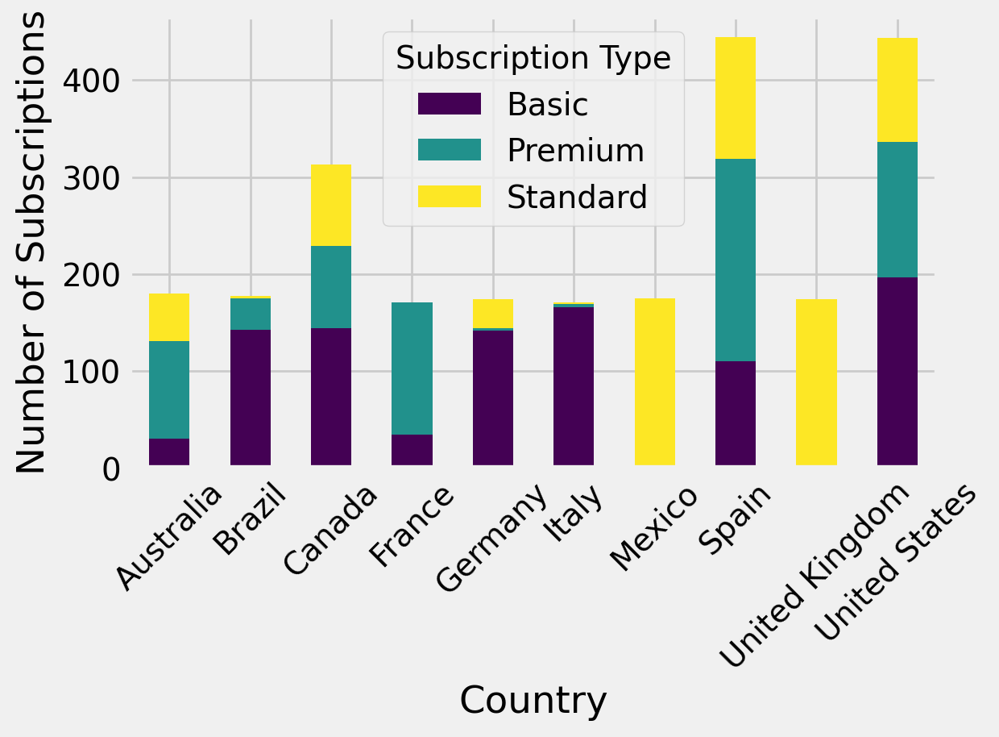

In [37]:
plt.figure(figsize=(16, 8))
subscription_counts.plot(kind='bar', stacked=True, colormap='viridis')

plt.xlabel('Country')
plt.ylabel('Number of Subscriptions')
plt.xticks(rotation=45)
plt.legend(title='Subscription Type')
plt.tight_layout()

plt.show()

In [38]:
subscription_counts = clean_df.groupby(['Country', 'Subscription_Type']).size().reset_index(name='Count')

total_counts = clean_df.groupby('Country').size().reset_index(name='Total_Count')

merged_counts = pd.merge(subscription_counts, total_counts, on='Country')

merged_counts['Percentage'] = (merged_counts['Count'] / merged_counts['Total_Count']) * 100

percentage_pivot = merged_counts.pivot(index='Country', columns='Subscription_Type', values='Percentage')

print(merged_counts)
print(percentage_pivot)

           Country Subscription_Type  Count  Total_Count  Percentage
0        Australia             Basic     31          180   17.222222
1        Australia           Premium    100          180   55.555556
2        Australia          Standard     49          180   27.222222
3           Brazil             Basic    143          178   80.337079
4           Brazil           Premium     32          178   17.977528
5           Brazil          Standard      3          178    1.685393
6           Canada             Basic    144          313   46.006390
7           Canada           Premium     85          313   27.156550
8           Canada          Standard     84          313   26.837061
9           France             Basic     35          171   20.467836
10          France           Premium    136          171   79.532164
11          France          Standard      0          171    0.000000
12         Germany             Basic    142          174   81.609195
13         Germany           Premi

In [39]:
subscription_counts = clean_df.groupby(['Month_Year', 'Subscription_Type']).size()

subscription_counts_unstacked = subscription_counts.unstack(fill_value=0)

print(subscription_counts_unstacked)

Subscription_Type  Basic  Premium  Standard
Month_Year                                 
2022-03                6        0         1
2022-04                6        2         7
2022-05               14       11        15
2022-06              121       87        87
2022-07              192      137       152
2022-08              152      116       114
2022-09              143      103       121
2022-10              220      161       140
2022-11              114       80       101
2022-12                6        9         5


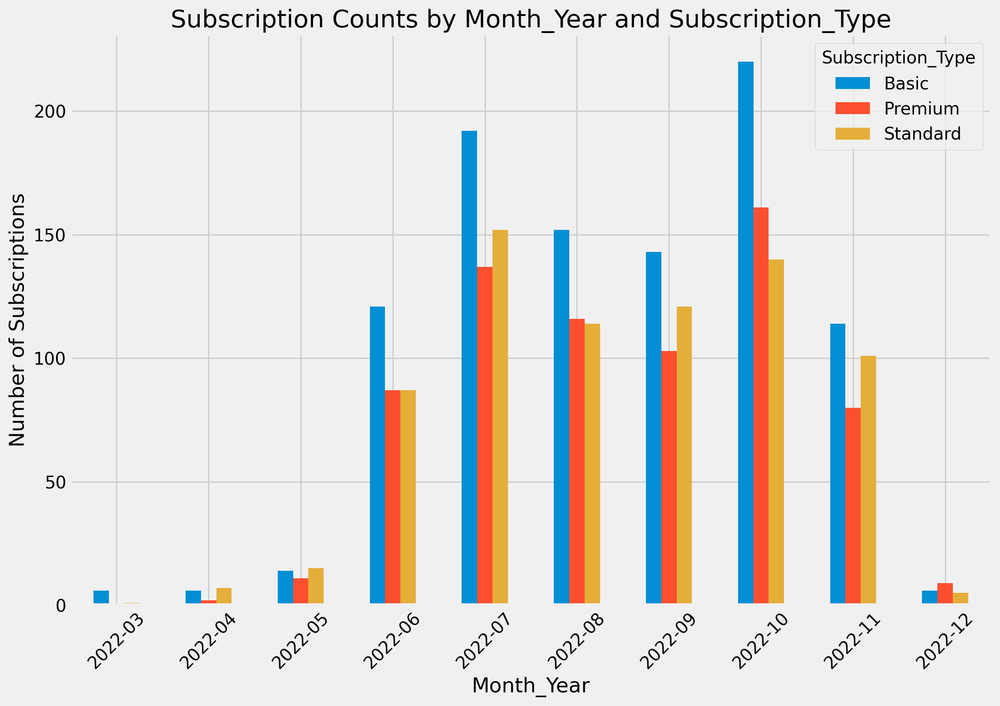

In [40]:
subscription_counts_unstacked.plot(kind='bar', figsize=(12, 8))

plt.title('Subscription Counts by Month_Year and Subscription_Type')
plt.xlabel('Month_Year')
plt.ylabel('Number of Subscriptions')
plt.xticks(rotation=45)
plt.legend(title='Subscription_Type')

plt.show()

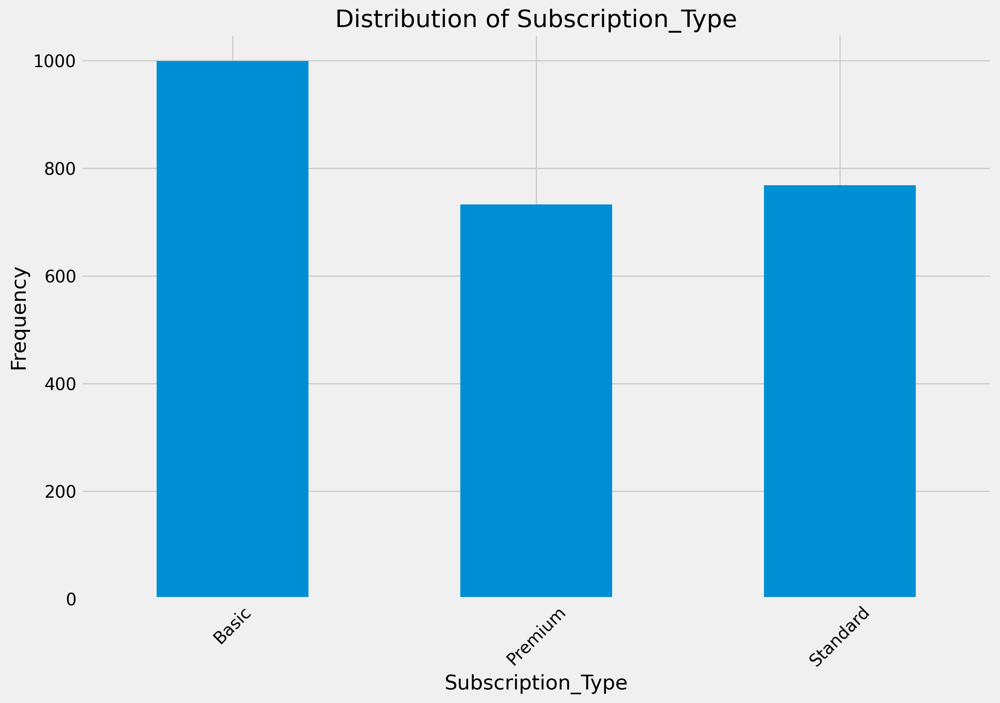

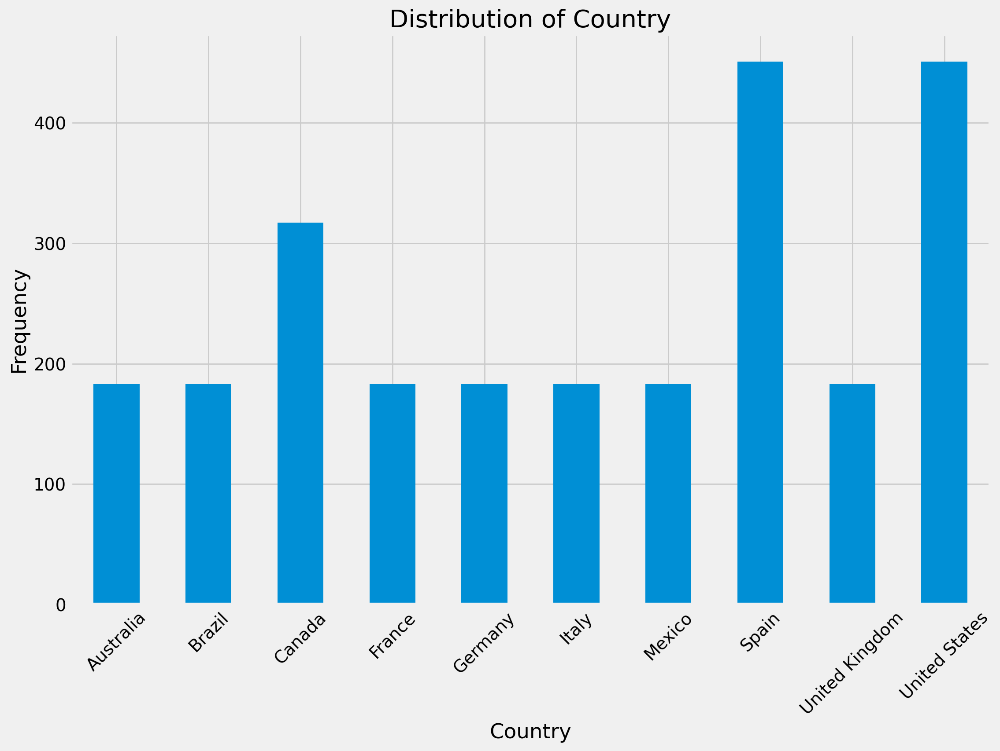

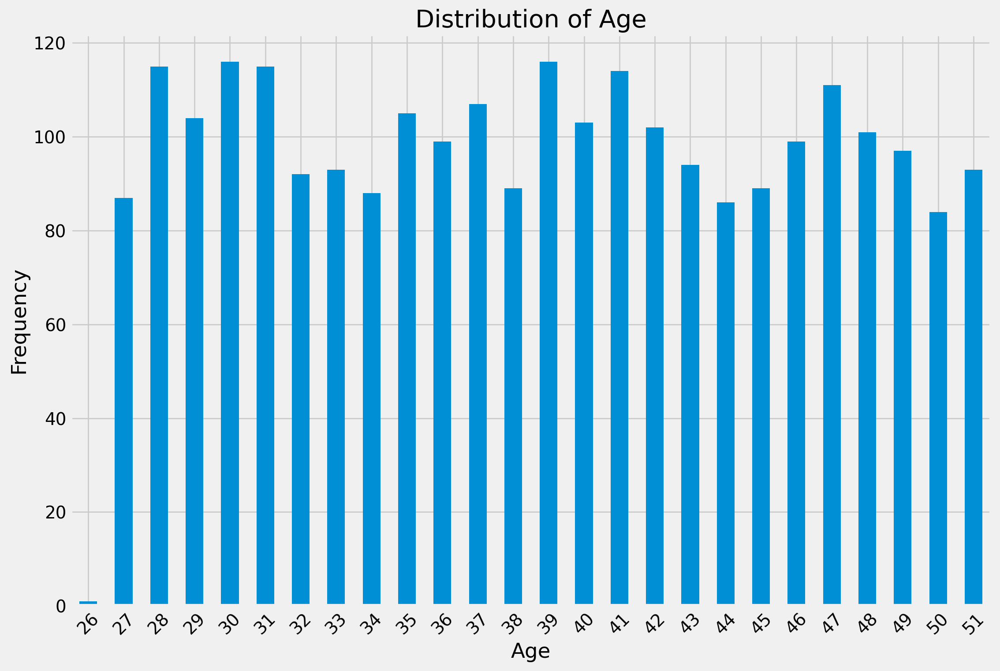

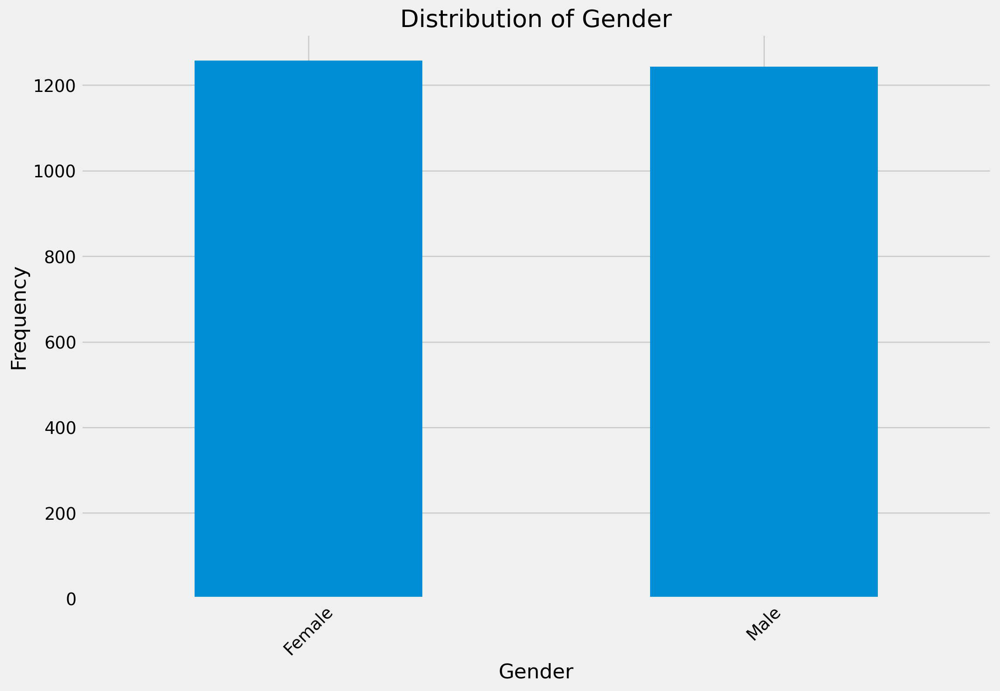

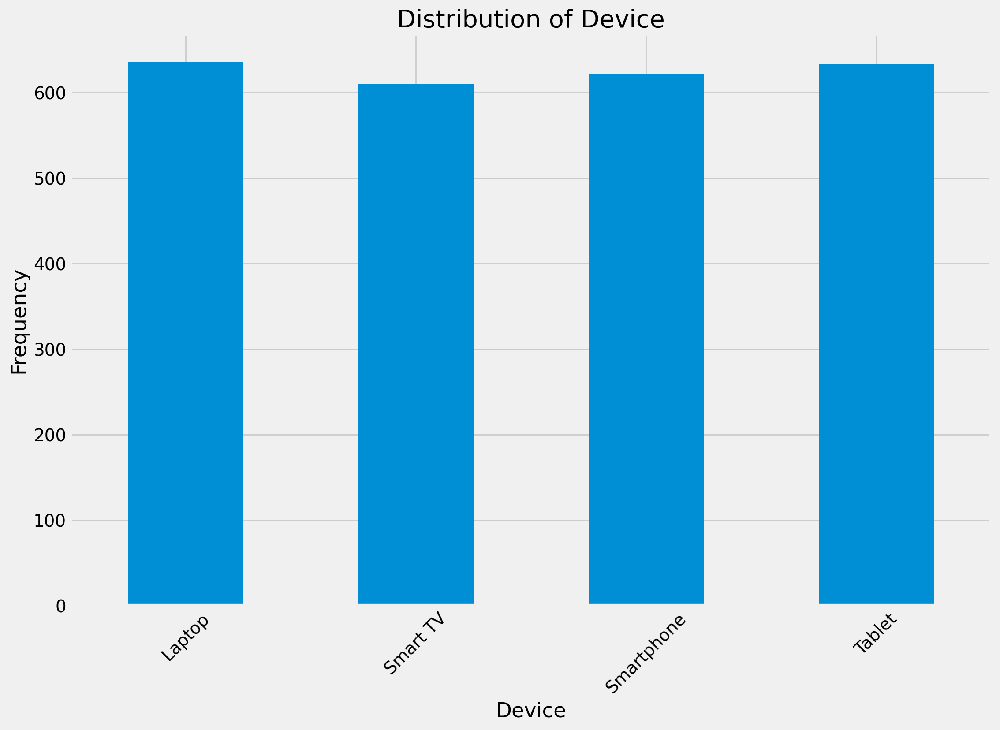

...

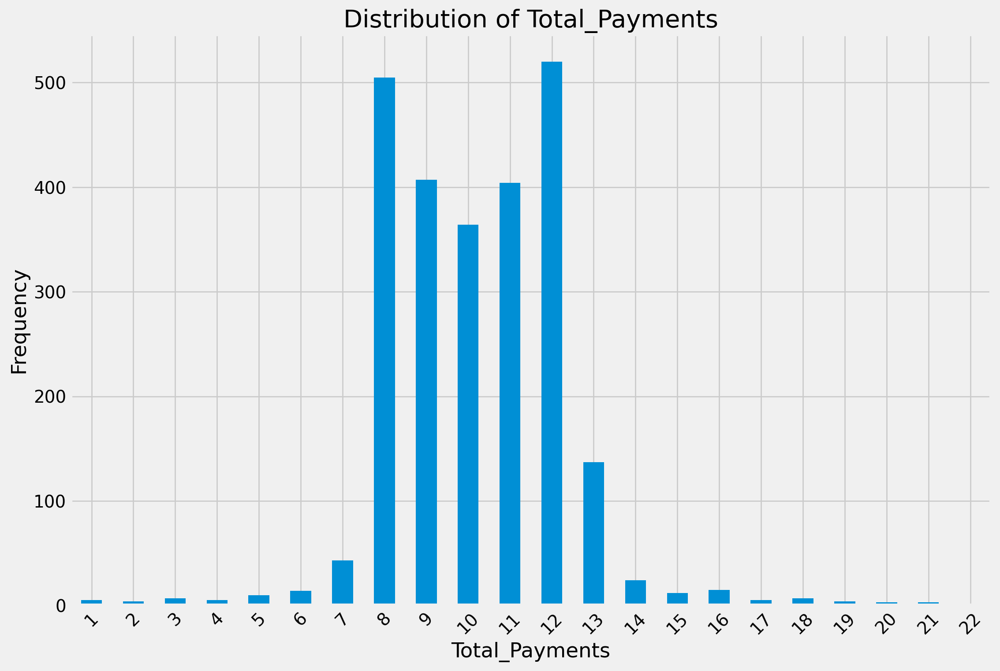

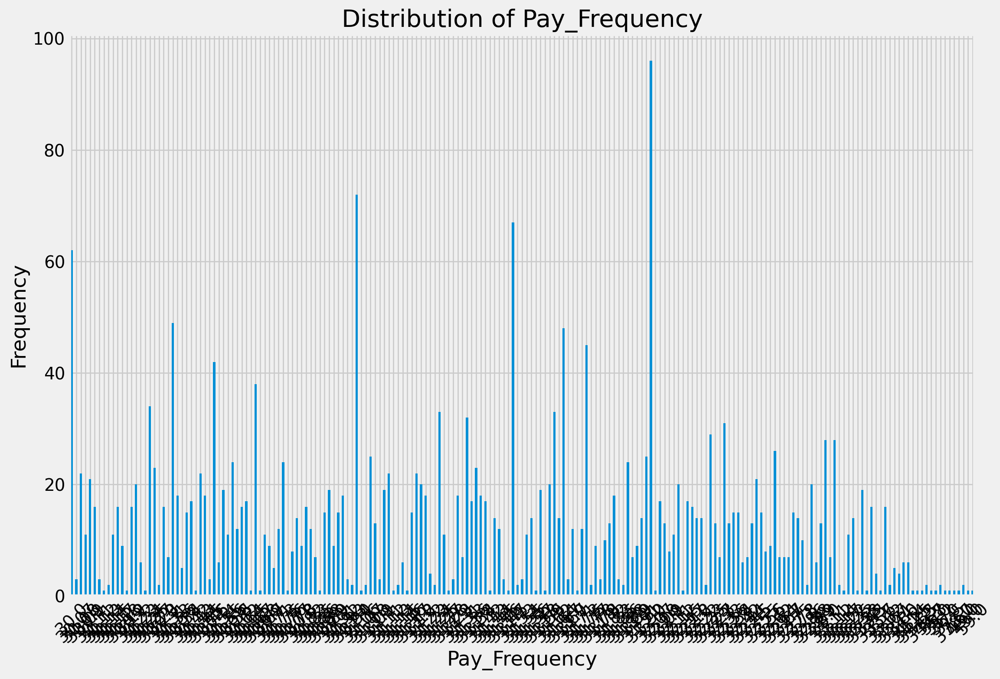

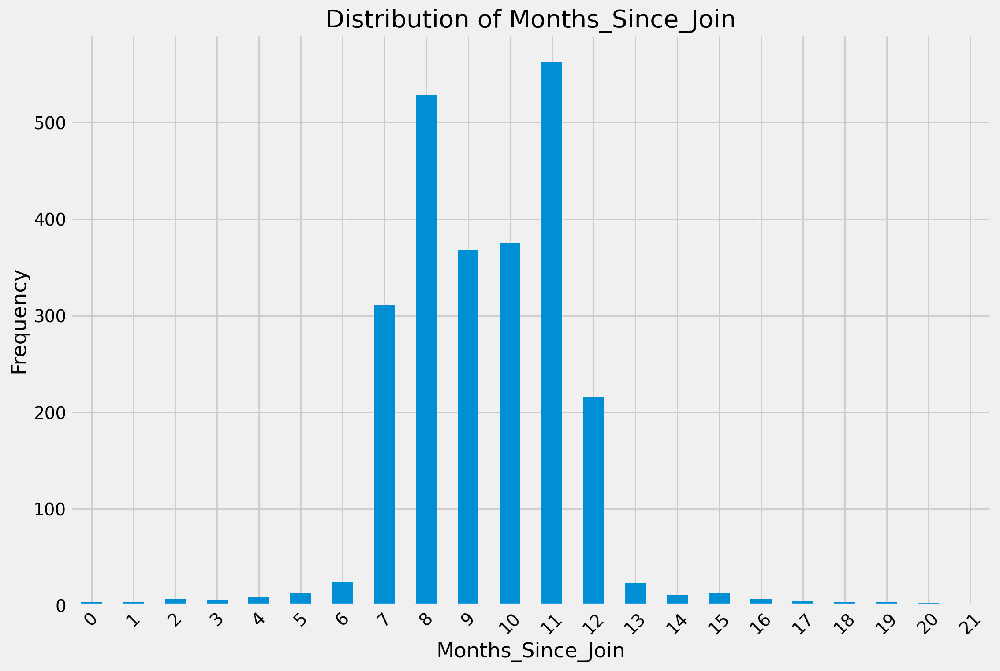

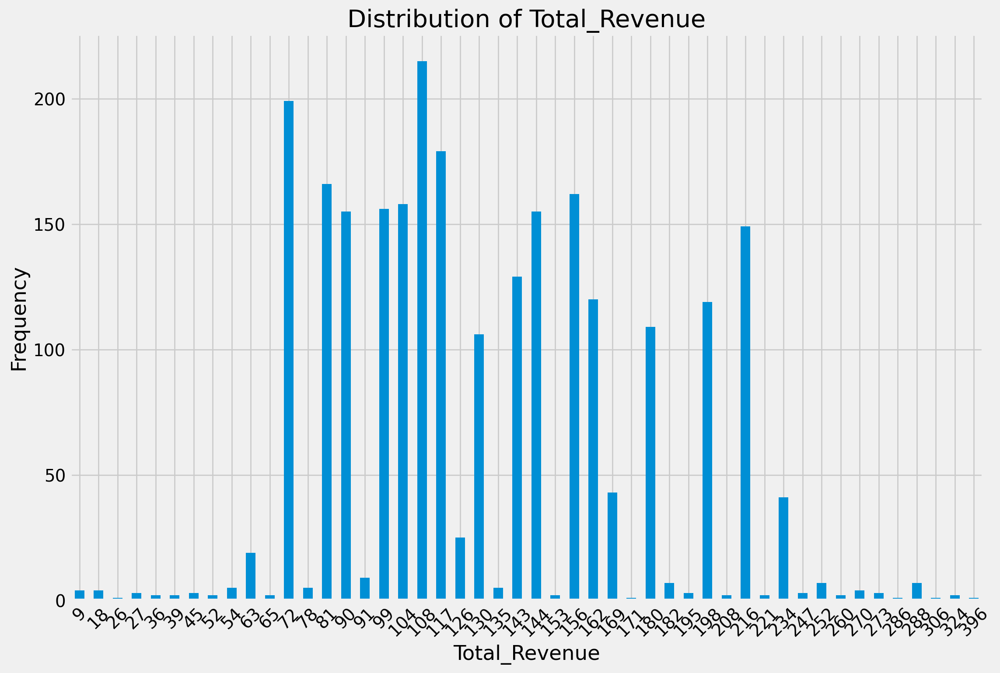

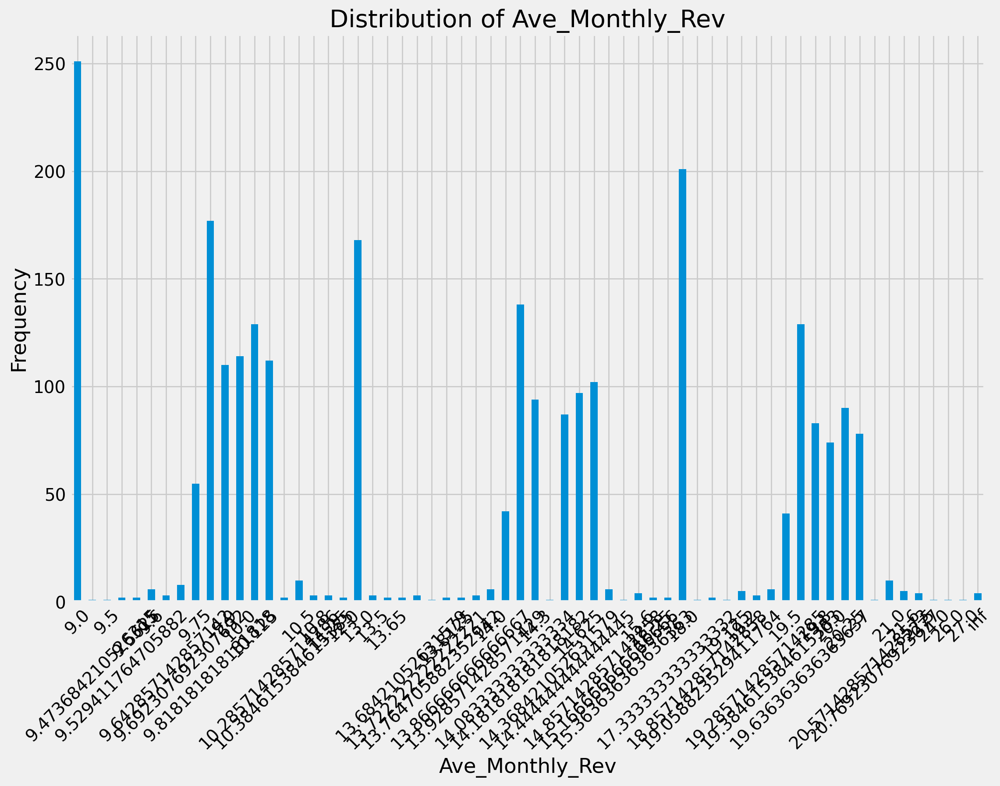

In [41]:
columns = clean_df.select_dtypes(include=['int', 'float', 'category']).columns

for col in columns:
    plt.figure(figsize=(12, 8))
    df[col].value_counts().sort_index().plot(kind='bar')
    plt.xticks(rotation=45)
    plt.title(f'Distribution of {col}')
    plt.xlabel(col)
    plt.ylabel('Frequency')
    plt.show()

In [42]:
categorical_columns = ['Subscription_Type', 'Country', 'Gender', 'Device']

le = LabelEncoder()

for column in categorical_columns:
    clean_df[column] = le.fit_transform(clean_df[column].astype(str))

In [43]:
clean_df.info()

<class 'pandas.core.frame.DataFrame'>
Index: 2423 entries, 3 to 2499
Data columns (total 23 columns):
 #   Column                Non-Null Count  Dtype         
---  ------                --------------  -----         
 0   Subscription_Type     2423 non-null   int32         
 1   Join_Date             2423 non-null   datetime64[ns]
 2   Last_Payment_Date     2423 non-null   datetime64[ns]
 3   Country               2423 non-null   int32         
 4   Age                   2423 non-null   int64         
 5   Gender                2423 non-null   int32         
 6   Device                2423 non-null   int32         
 7   Subscription_Revenue  2423 non-null   int64         
 8   Month_Year            2423 non-null   period[M]     
 9   Join_Year             2423 non-null   int32         
 10  Join_Month            2423 non-null   int32         
 11  Last_Pay_Year         2423 non-null   int32         
 12  Last_Pay_Month        2423 non-null   int32         
 13  Last_Pay_Day          2

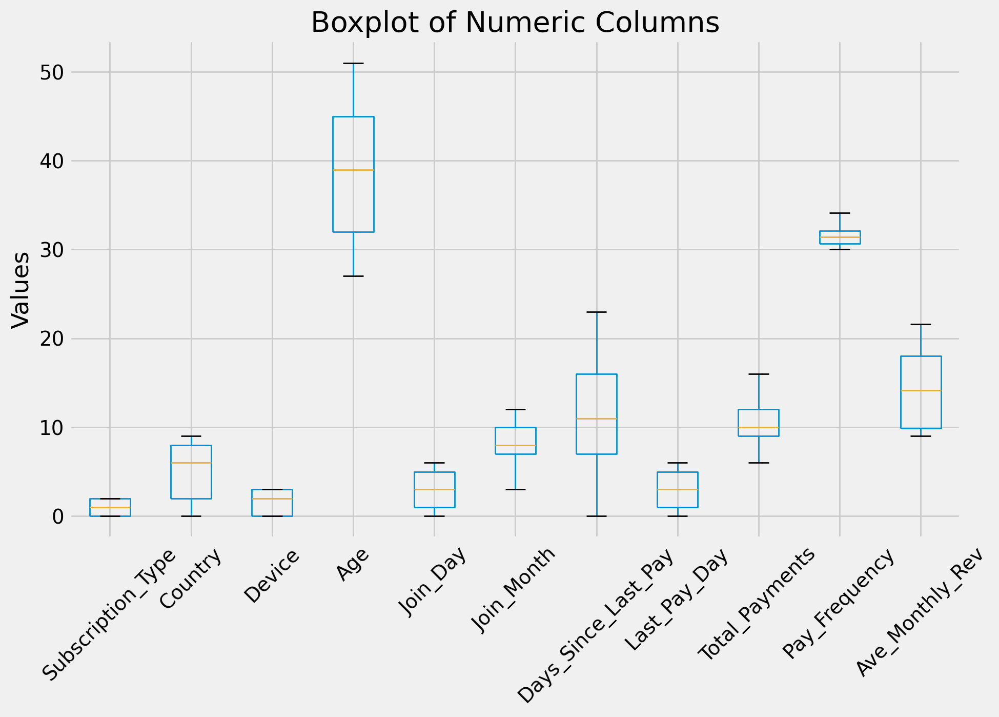

In [44]:
columns_of_interest = clean_df.loc[:, clean_df.nunique() > 2]

columns_to_plot = columns_of_interest[['Subscription_Type', 'Country', 'Device', 'Age', 'Join_Day', 'Join_Month', 'Days_Since_Last_Pay', 'Last_Pay_Day', 'Total_Payments', 'Pay_Frequency', 'Ave_Monthly_Rev']]

plt.figure(figsize=(10, 6))
columns_to_plot.boxplot()

plt.title('Boxplot of Numeric Columns')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.show()

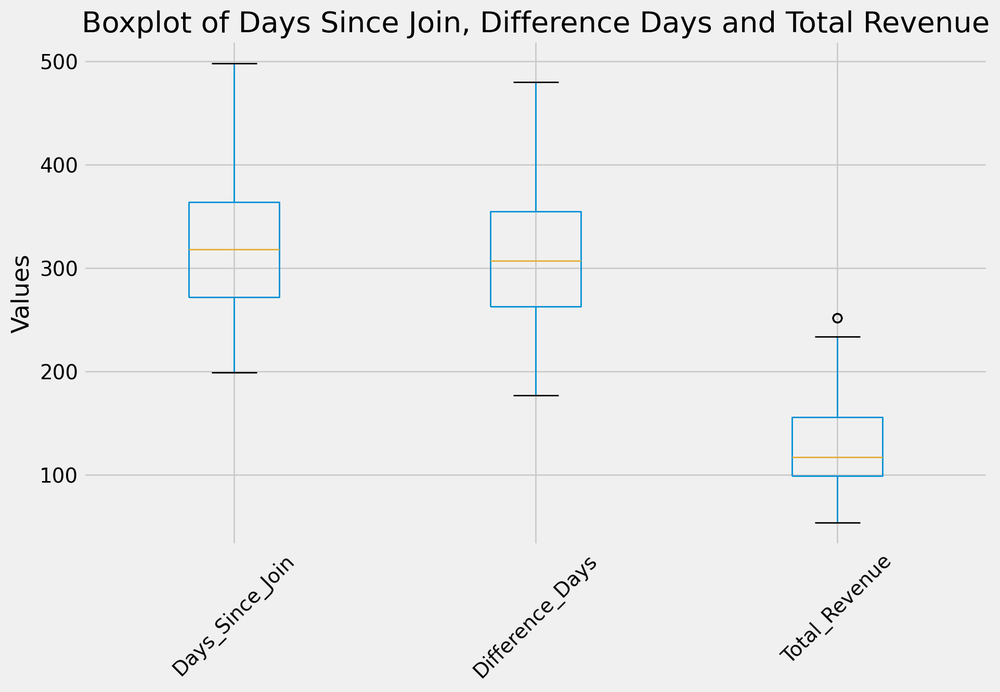

In [45]:
columns_of_interest = clean_df.loc[:, clean_df.nunique() > 2]

columns_to_plot = columns_of_interest[['Days_Since_Join', 'Difference_Days', 'Total_Revenue']]

plt.figure(figsize=(10, 6))
columns_to_plot.boxplot()

plt.title('Boxplot of Days Since Join, Difference Days and Total Revenue')
plt.ylabel('Values')
plt.xticks(rotation=45)
plt.show()

# Feature Selection

In [46]:
clean_df = clean_df.drop(columns=['Last_Pay_Year', 'Join_Year'])

corr_matrix = clean_df.select_dtypes(include=[float, int]).corr()

print(corr_matrix)

                      Subscription_Type   Country       Age    Gender  \
Subscription_Type              1.000000  0.198791  0.010792  0.016565   
Country                        0.198791  1.000000  0.024620  0.002460   
Age                            0.010792  0.024620  1.000000 -0.038485   
Gender                         0.016565  0.002460 -0.038485  1.000000   
Device                         0.010818 -0.015641 -0.017604 -0.004219   
Subscription_Revenue           0.514873  0.019906 -0.012019  0.015585   
Join_Month                     0.001337  0.049515 -0.023665 -0.007870   
Last_Pay_Month                 0.018722  0.078898  0.018870  0.000102   
Last_Pay_Day                  -0.003635  0.016876  0.039418  0.001946   
Join_Day                       0.030275 -0.000769  0.028328  0.005005   
Days_Since_Join               -0.002465 -0.050581  0.019149  0.006837   
Days_Since_Last_Pay           -0.004936 -0.064247  0.002327  0.017800   
Difference_Days               -0.001993 -0.044698  

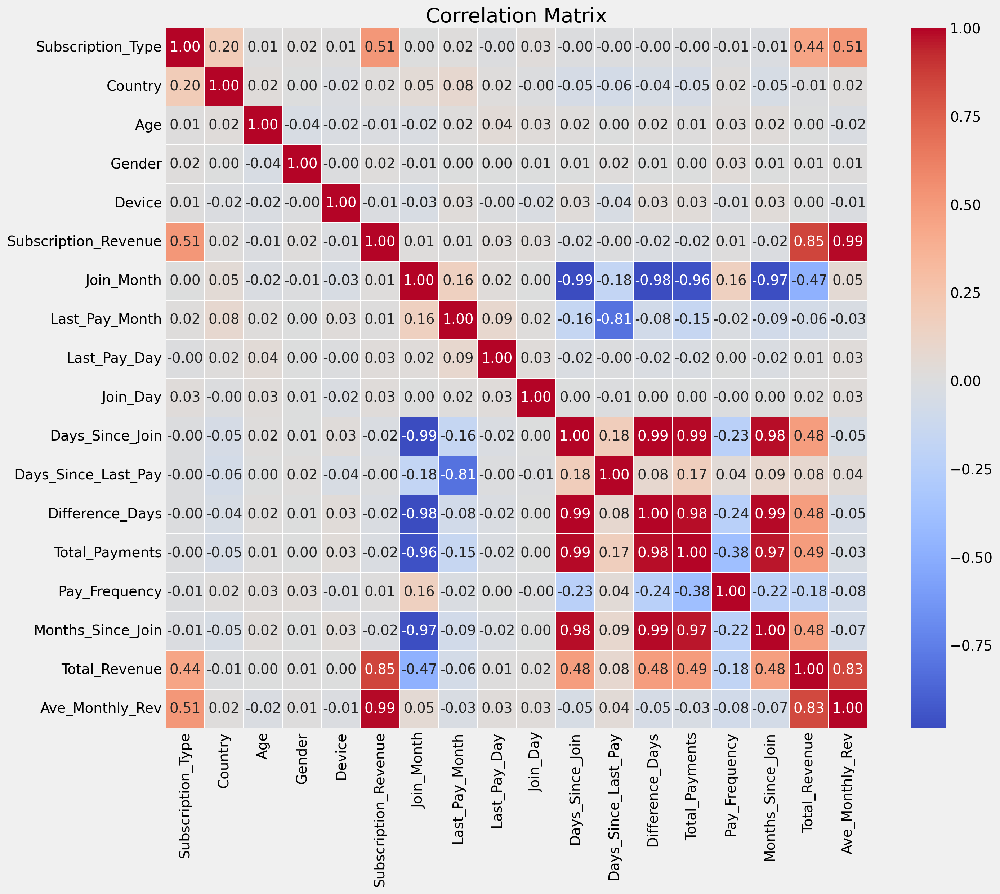

In [47]:
plt.figure(figsize=(14, 12))
sns.heatmap(corr_matrix, annot=True, cmap='coolwarm', fmt='.2f', linewidths=0.10)
plt.title('Correlation Matrix')
plt.xticks(rotation=90)
plt.show()

In [48]:
target = 'Total_Revenue'
num_features = clean_df.select_dtypes(include=[np.number]).columns.drop(target)

correlations = clean_df[num_features].corrwith(clean_df[target])

threshold = 0.1
selected_num_features = correlations[abs(correlations) > threshold].index.tolist()

print(selected_num_features)

['Subscription_Type', 'Subscription_Revenue', 'Join_Month', 'Days_Since_Join', 'Difference_Days', 'Total_Payments', 'Pay_Frequency', 'Months_Since_Join', 'Ave_Monthly_Rev']


In [49]:
clean_df = clean_df.drop(columns=['Month_Year'])

corr_matrix = clean_df.corr()

total_revenue_correlations = corr_matrix['Total_Revenue'].abs().sort_values(ascending=False)

best_predictor = total_revenue_correlations.index[1]  

print("Best predictor for Total Revenue:", best_predictor)
print("Correlation coefficient:", total_revenue_correlations.iloc[1])

Best predictor for Total Revenue: Subscription_Revenue
Correlation coefficient: 0.8496630622115394


In [50]:
features = ['Subscription_Type', 'Subscription_Revenue', 'Join_Month', 'Days_Since_Join', 'Difference_Days', 'Total_Payments', 'Pay_Frequency', 'Months_Since_Join', 'Ave_Monthly_Rev']
target = ['Total_Revenue'] 

In [51]:
X = clean_df[features]
y = clean_df[target]

In [52]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [53]:
lasso_pipeline = Pipeline([
    ('scaler', StandardScaler()),   
    ('lasso', Lasso())      
])

y_train = y_train.values.ravel()
y_test = y_test.values.ravel()

lasso_pipeline.fit(X_train, y_train)

y_train_pred = lasso_pipeline.predict(X_train)
y_test_pred = lasso_pipeline.predict(X_test)

train_mse = mean_squared_error(y_train, y_train_pred)
test_mse = mean_squared_error(y_test, y_test_pred)

print(f"Lasso Regression Train MSE: {train_mse}")
print(f"Lasso Regression Test MSE: {test_mse}")

param_grid = {'lasso__alpha': [0.1, 1.0, 10.0, 100.0]}

lasso_grid_search = GridSearchCV(lasso_pipeline, param_grid=param_grid, cv=5, scoring='neg_mean_squared_error')
lasso_grid_search.fit(X_train, y_train)

print(f"Best Lasso alpha: {lasso_grid_search.best_params_['lasso__alpha']}")
print(f"Best Lasso MSE: {-lasso_grid_search.best_score_}")

Lasso Regression Train MSE: 42.57515721082552
Lasso Regression Test MSE: 45.45380178070619
Best Lasso alpha: 0.1
Best Lasso MSE: 40.81365950164637


In [54]:
lasso_model = lasso_pipeline.named_steps['lasso']

coefficients = lasso_model.coef_
feature_names = X.columns

feature_importance = pd.DataFrame({'Feature': feature_names, 'Coefficient': coefficients})

feature_importance['Absolute_Coefficient'] = feature_importance['Coefficient'].abs()
feature_importance = feature_importance.sort_values(by='Absolute_Coefficient', ascending=False)

print(feature_importance[['Feature', 'Coefficient']])

                Feature  Coefficient
1  Subscription_Revenue    36.665977
5        Total_Payments    21.000369
0     Subscription_Type     0.000000
2            Join_Month    -0.000000
3       Days_Since_Join     0.000000
4       Difference_Days     0.000000
6         Pay_Frequency    -0.000000
7     Months_Since_Join     0.000000
8       Ave_Monthly_Rev     0.000000


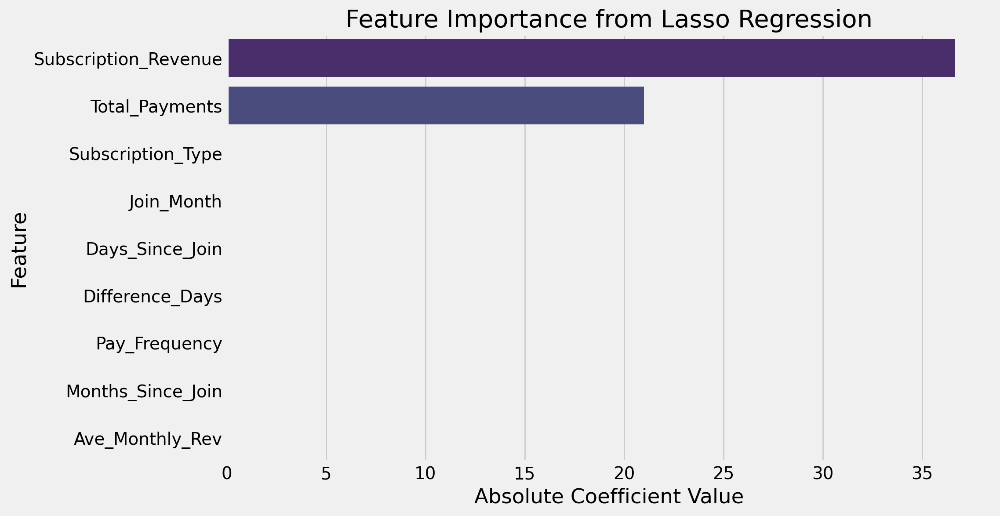

In [55]:
plt.figure(figsize=(10, 6))
sns.barplot(x='Absolute_Coefficient', y='Feature', data=feature_importance, palette='viridis')
plt.title('Feature Importance from Lasso Regression')
plt.xlabel('Absolute Coefficient Value')
plt.ylabel('Feature')
plt.show()

# Business Question Pipeline And Models

In [56]:
features = ['Subscription_Revenue', 'Total_Payments']
target = ['Total_Revenue'] 

In [57]:
X = clean_df[features]
y = clean_df[target]

[LightGBM] [Info] Auto-choosing row-wise multi-threading, the overhead of testing was 0.000728 seconds.
You can set `force_row_wise=true` to remove the overhead.
And if memory is not enough, you can set `force_col_wise=true`.
[LightGBM] [Info] Total Bins 16
[LightGBM] [Info] Number of data points in the train set: 1550, number of used features: 2
[LightGBM] [Info] Start training from score 131.116774
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -

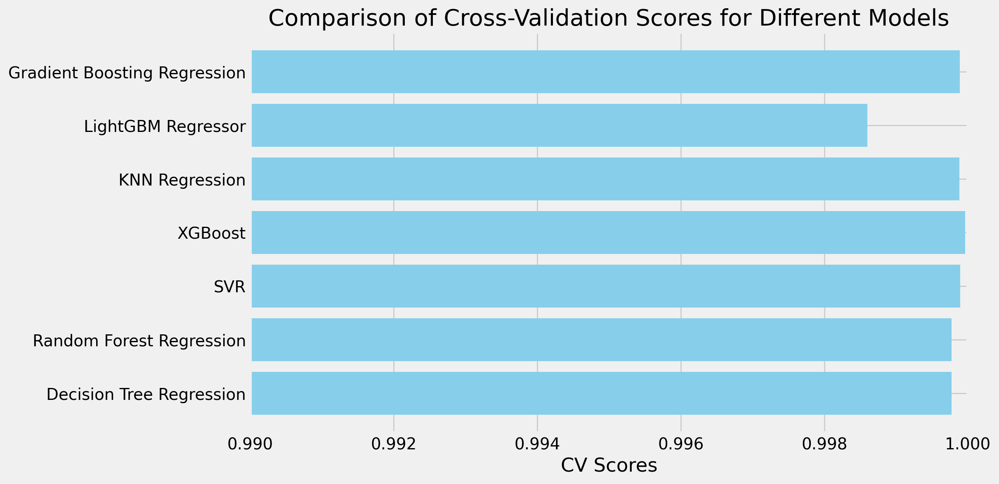

In [58]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42) 

preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), features),
    ])         

models = {
    'Decision Tree Regression': {
        'model': DecisionTreeRegressor(),
        'params': {  
            'regressor__max_depth': [3, 5, 10],  
            'regressor__min_samples_split': [2, 5, 10, 20],  
            'regressor__min_samples_leaf': [1, 2, 4, 8],
        }
    },
    'Random Forest Regression': {
        'model': RandomForestRegressor(),
        'params': {
            'regressor__n_estimators': [100, 200, 300],   
            'regressor__min_samples_split': [2, 5, 10, 20],  
            'regressor__min_samples_leaf': [1, 2, 4, 8], 
            'regressor__bootstrap': [True, False],
        }
    },
    'SVR': {
        'model': SVR(),
        'params': {
            'regressor__C': [0.1, 1, 10, 100],  
            'regressor__kernel': ['linear', 'rbf'],
            'regressor__gamma': ['scale', 'auto'],  
            'regressor__epsilon': [0.01, 0.1],
        }
    },
    'XGBoost': {
        'model': XGBRegressor(objective='reg:squarederror'),
        'params': {
            'regressor__n_estimators': [100, 200, 300],
            'regressor__learning_rate': [0.01, 0.05, 0.1],
            'regressor__max_depth': [3, 5, 10],  
            'regressor__subsample': [0.6, 0.8, 1.0],  
        }
    },
    'KNN Regression': {
        'model': KNeighborsRegressor(),
        'params': {
            'regressor__n_neighbors': [3, 5, 7, 10],  # Increase neighbors to reduce overfitting
            'regressor__weights': ['uniform', 'distance'],
        }
    },
    'LightGBM Regressor': {
        'model': LGBMRegressor(),
        'params': {
            'regressor__num_leaves': [31, 50, 100],
            'regressor__learning_rate': [0.01, 0.05, 0.1],
            'regressor__n_estimators': [100, 200, 300],
            'regressor__subsample': [0.6, 0.8, 1.0],
        }
    },
    'Gradient Boosting Regression': {
        'model': GradientBoostingRegressor(),
        'params': {
            'regressor__n_estimators': [100, 200, 300],
            'regressor__learning_rate': [0.01, 0.05, 0.1],
            'regressor__max_depth': [3, 5, 10], 
            'regressor__subsample': [0.6, 0.8, 1.0],
        }
    }
}

results = []
for model_name, model_info in models.items():
    grid_search = GridSearchCV(Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('regressor', model_info['model'])
    ]), model_info['params'], cv=5, scoring='r2', return_train_score=True)

    grid_search.fit(X_train, y_train)

    best_score = grid_search.best_score_
    best_params = grid_search.best_params_
    cv_scores = grid_search.cv_results_['mean_test_score'][grid_search.best_index_]

    results.append({
        'model': model_name,
        'best_params': best_params,
        'best_score': best_score,
        'cv_scores': grid_search.cv_results_['split0_test_score'][grid_search.best_index_:grid_search.best_index_ + 5]
    })

for result in results:
    print(f"Model: {result['model']}")
    print(f"Best Cross-Validation Score: {result['best_score']:.5f}")
    print(f"Best Hyperparameters: {result['best_params']}")
    print(f"Cross-Validation Scores: {result['cv_scores']}\n")

best_model_info = max(results, key=lambda x: x['best_score'])
best_model_name = best_model_info['model']
best_params = best_model_info['best_params']
best_score = best_model_info['best_score']

print(f"\nOverall Best Model: {best_model_name}")
print(f"Best Hyperparameters: {best_params}")
print(f"Best Cross-Validation Score: {best_score:.5f}")

best_model = models[best_model_name]['model']
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', best_model)
])

pipeline.set_params(**best_params)  

pipeline.fit(X_train, y_train)

y_train_pred = pipeline.predict(X_train)
train_mae = mean_absolute_error(y_train, y_train_pred)
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)

print(f"\nTraining Set Performance:")
print(f"Mean Absolute Error (MAE): {train_mae:.5f}")
print(f"Mean Squared Error (MSE): {train_mse:.5f}")
print(f"R-squared (R2): {train_r2:.5f}")

y_test_pred = pipeline.predict(X_test)
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)

print(f"\nTest Set Performance:")
print(f"Mean Absolute Error (MAE): {test_mae:.5f}")
print(f"Mean Squared Error (MSE): {test_mse:.5f}")
print(f"R-squared (R2): {test_r2:.5f}")

plt.figure(figsize=(10, 6))
model_names = [result['model'] for result in results]
test_scores = [result['best_score'] for result in results]
plt.barh(model_names, test_scores, color='skyblue')
plt.xlabel('CV Scores')
plt.title('Comparison of Cross-Validation Scores for Different Models')
plt.xlim(0.99, 1.0)
plt.show()

# Results

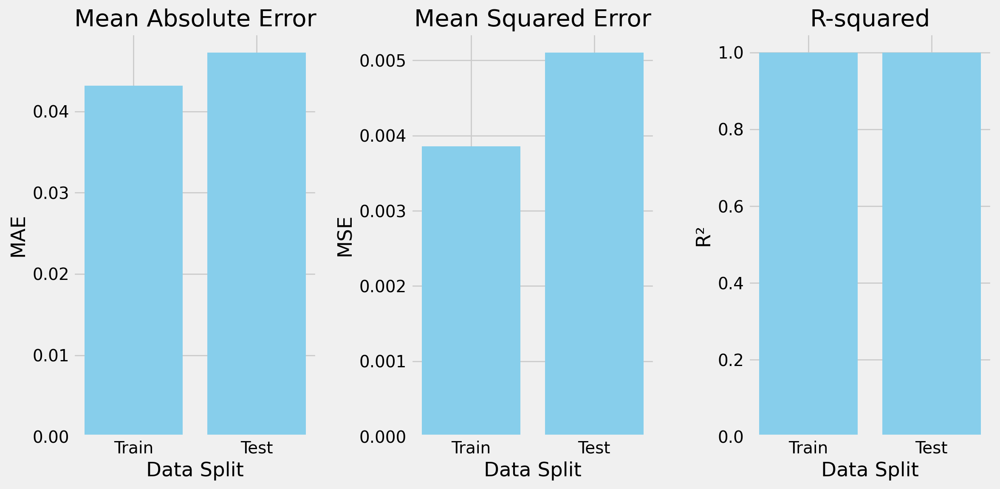

In [59]:
labels = ['Train', 'Test']
mae_values = [train_mae, test_mae]
mse_values = [train_mse, test_mse]
r2_values = [train_r2, test_r2]

x = range(len(labels))

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.bar(x, mae_values, color='skyblue')
plt.xticks(x, labels)
plt.xlabel('Data Split')
plt.ylabel('MAE')
plt.title('Mean Absolute Error')

plt.subplot(1, 3, 2)
plt.bar(x, mse_values, color='skyblue')
plt.xticks(x, labels)
plt.xlabel('Data Split')
plt.ylabel('MSE')
plt.title('Mean Squared Error')

plt.subplot(1, 3, 3)
plt.bar(x, r2_values, color='skyblue')
plt.xticks(x, labels)
plt.xlabel('Data Split')
plt.ylabel('R²')
plt.title('R-squared')

plt.tight_layout()
plt.show()

Shape of y_test after flattening: (485,)
     Actual   Predicted
0       180  179.999939
1        99   99.007027
2        90   89.991631
3       234  234.048203
4        90   89.991631
..      ...         ...
480     180  179.999939
481     234  234.048203
482     156  156.088928
483      99   99.007027
484     180  179.999939

[485 rows x 2 columns]


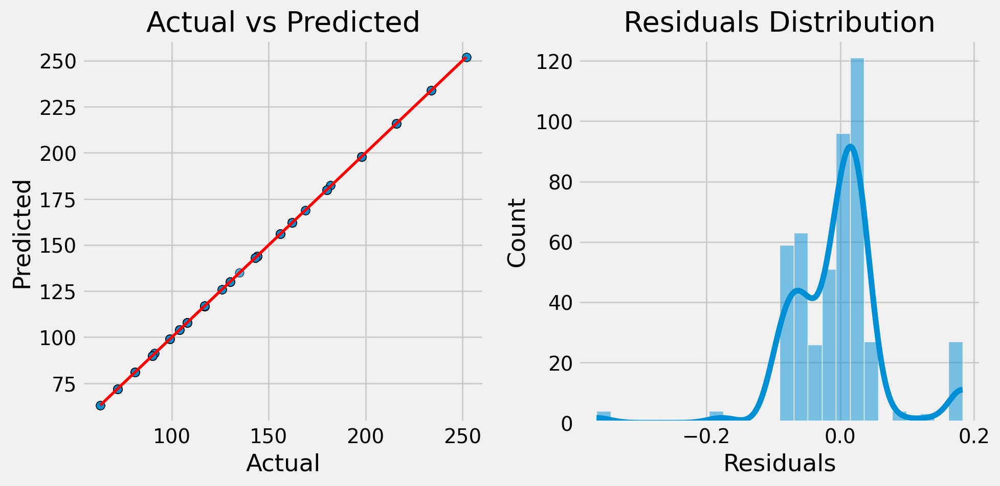

In [60]:
if isinstance(y_test, pd.DataFrame) or isinstance(y_test, pd.Series):
    y_test = y_test.to_numpy() 

if y_test.ndim > 1:
    y_test = y_test.ravel()  

print(f"Shape of y_test after flattening: {y_test.shape}")

results = pd.DataFrame({'Actual': y_test, 'Predicted': y_test_pred})

print(results)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.scatter(y_test, y_test_pred, edgecolor='k', alpha=0.7)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='r', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')

plt.subplot(1, 2, 2)
residuals = y_test - y_test_pred
sns.histplot(residuals, kde=True)
plt.xlabel('Residuals')
plt.title('Residuals Distribution')

plt.tight_layout()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Average Actual Revenue: 129.48
Average Predicted Revenue: 129.48


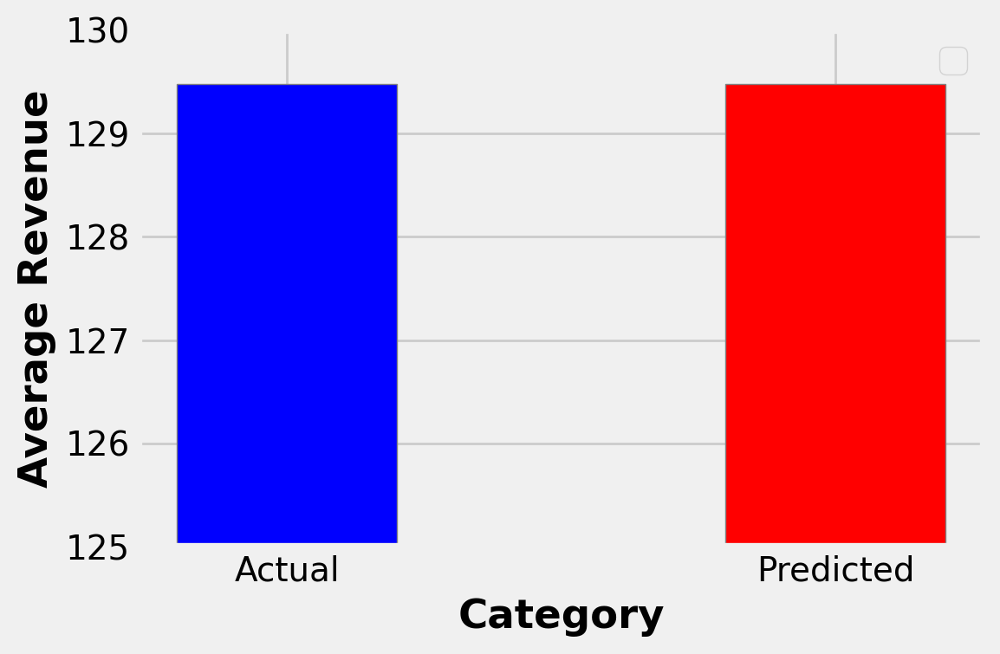

In [61]:
average_actual = results['Actual'].mean()
average_predicted = results['Predicted'].mean()

print(f"Average Actual Revenue: {average_actual:.2f}")
print(f"Average Predicted Revenue: {average_predicted:.2f}")

plt.figure(figsize=(6, 4))

bar_positions = np.arange(2)

plt.bar(bar_positions[0], average_actual, color='blue', width=0.4, edgecolor='grey')
plt.bar(bar_positions[1], average_predicted, color='red', width=0.4, edgecolor='grey')

plt.xlabel('Category', fontweight='bold')
plt.ylabel('Average Revenue', fontweight='bold')

plt.xticks(bar_positions, ['Actual', 'Predicted'])

plt.ylim(125, 130)

plt.legend()

plt.tight_layout()
plt.show()

# Data Question Pipeline and Models

In [62]:
rows_to_update = clean_df[clean_df['Subscription_Revenue'] == 13].index

num_rows_to_update = 74  
rows_to_update = rows_to_update[:num_rows_to_update]

clean_df.loc[rows_to_update, 'Subscription_Revenue'] = 18

clean_df['Total_Revenue'] = clean_df['Subscription_Revenue'] * clean_df['Total_Payments']

In [63]:
subscription_revenue_counts = clean_df['Subscription_Revenue'].value_counts()

print("Counts of each Subscription_Revenue value:")
print(subscription_revenue_counts)

Counts of each Subscription_Revenue value:
Subscription_Revenue
9     974
18    780
13    669
Name: count, dtype: int64


   Subscription_Revenue  User_Count  Percentage
0                     9         974   40.198102
1                    13         669   27.610400
2                    18         780   32.191498


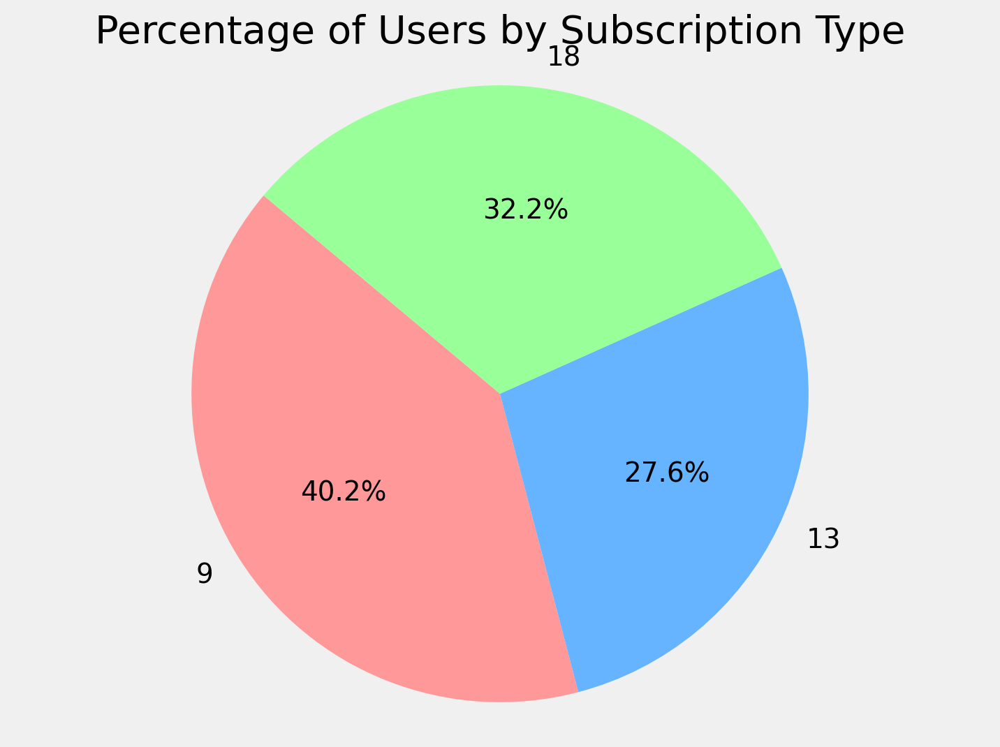

In [64]:
user_counts = clean_df.groupby('Subscription_Revenue').size().reset_index(name='User_Count')

total_users = clean_df.shape[0]
user_counts['Percentage'] = (user_counts['User_Count'] / total_users) * 100

print(user_counts)

plt.figure(figsize=(8, 6))
plt.pie(user_counts['Percentage'], labels=user_counts['Subscription_Revenue'], autopct='%1.1f%%', startangle=140, colors=['#ff9999','#66b3ff','#99ff99','#ffcc99'])
plt.title('Percentage of Users by Subscription Type')
plt.axis('equal') 
plt.show()

                      Total_Revenue  Percentage_of_Total
Subscription_Revenue                                    
9                             89559            27.907477
13                            88309            27.517964
18                           143046            44.574559


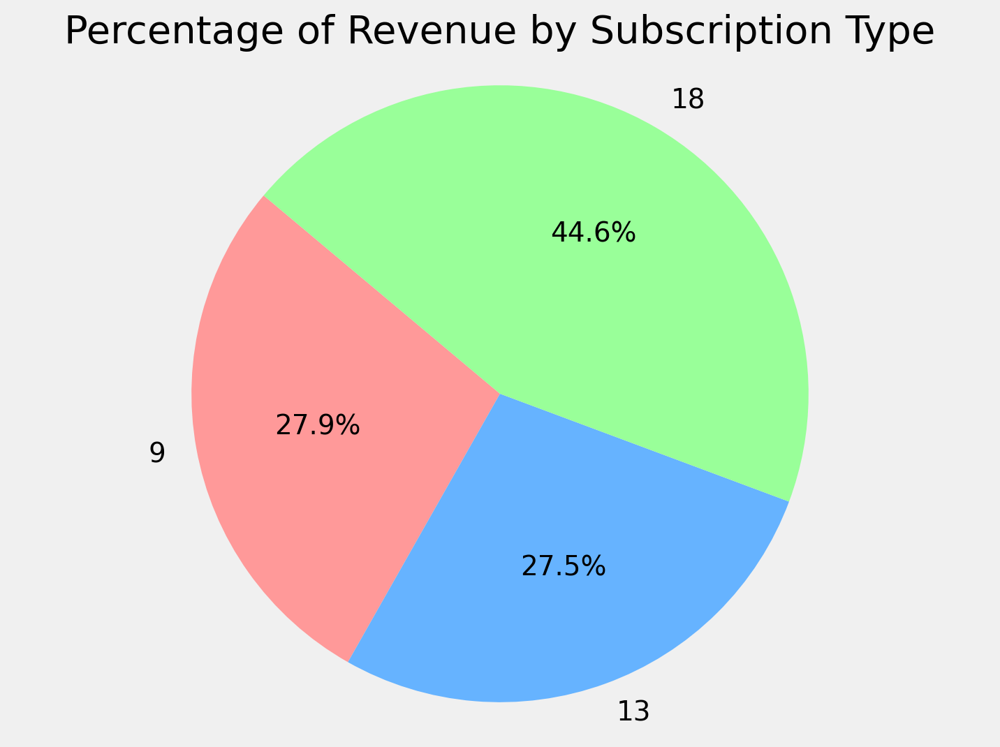

In [65]:
revenue_by_subscription = clean_df.groupby('Subscription_Revenue')['Total_Revenue'].sum()

total_revenue = revenue_by_subscription.sum()

percentage_by_subscription = (revenue_by_subscription / total_revenue) * 100

percentage_df = pd.DataFrame({
    'Total_Revenue': revenue_by_subscription,
    'Percentage_of_Total': percentage_by_subscription
})

print(percentage_df)

colors = ['#ff9999', '#66b3ff', '#99ff99', '#ffcc99'] 

# Plot
plt.figure(figsize=(8, 6))
plt.pie(percentage_by_subscription, labels=percentage_by_subscription.index, autopct='%1.1f%%', startangle=140,
        colors=colors)  
plt.title('Percentage of Revenue by Subscription Type')
plt.axis('equal')  
plt.show()

In [66]:
combined_total_revenue = clean_df['Total_Revenue'].sum()

print(f"The combined total of Total_Revenue is: {combined_total_revenue}")

The combined total of Total_Revenue is: 320914


In [67]:
target = ['Total_Revenue']
features = ['Subscription_Revenue', 'Total_Payments']

In [68]:
X = clean_df[features]
y = clean_df[target]

[LightGBM] [Info] Auto-choosing col-wise multi-threading, the overhead of testing was 0.000051 seconds.
You can set `force_col_wise=true` to remove the overhead.
[LightGBM] [Info] Total Bins 16
[LightGBM] [Info] Number of data points in the train set: 1550, number of used features: 2
[LightGBM] [Info] Start training from score 132.720000
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, b

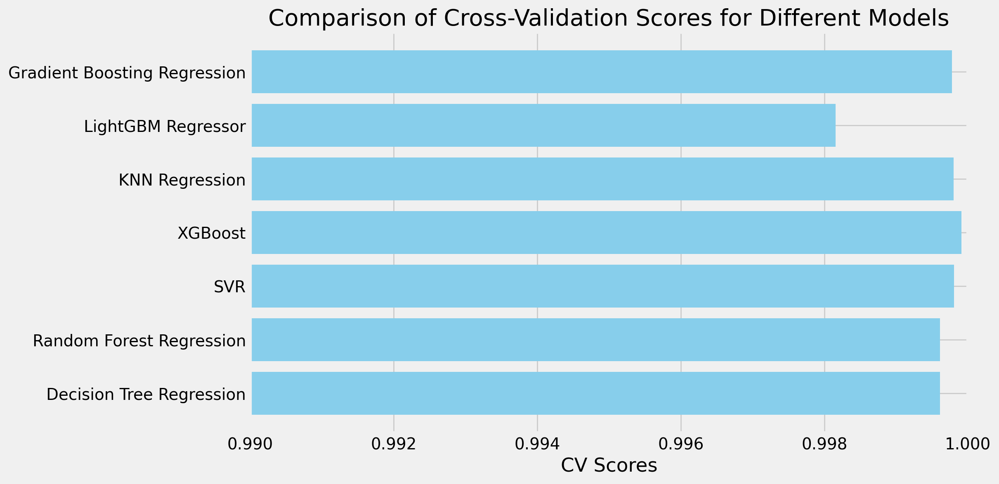

In [69]:
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

preprocessor = ColumnTransformer(
    transformers=[
        ('num', StandardScaler(), features),
    ])

models = {
    'Decision Tree Regression': {
        'model': DecisionTreeRegressor(),
        'params': {
            'regressor__max_depth': [None, 3, 5, 10],  
            'regressor__min_samples_split': [2, 5, 10, 20],  
            'regressor__min_samples_leaf': [1, 2, 4, 8],  
        }
    },
    'Random Forest Regression': {
        'model': RandomForestRegressor(),
        'params': {
            'regressor__n_estimators': [100, 200, 300],  
            'regressor__min_samples_split': [2, 5, 10, 20],  
            'regressor__min_samples_leaf': [1, 2, 4, 8], 
            'regressor__bootstrap': [True, False],  
        }
    },
    'SVR': {
        'model': SVR(),
        'params': {
            'regressor__C': [0.1, 1, 10, 100],  
            'regressor__kernel': ['linear', 'rbf'],  
            'regressor__gamma': ['scale', 'auto'],  
            'regressor__epsilon': [0.01, 0.1],
        }
    },
    'XGBoost': {
        'model': XGBRegressor(objective='reg:squarederror'),
        'params': {
            'regressor__n_estimators': [100, 200, 300],  
            'regressor__learning_rate': [0.01, 0.05, 0.1],  
            'regressor__max_depth': [3, 5, 10],    
            'regressor__subsample': [0.6, 0.8, 1.0]
        }
    },
    'KNN Regression': {
        'model': KNeighborsRegressor(),
        'params': {
            'regressor__n_neighbors': [3, 5, 7, 9],  
            'regressor__weights': ['uniform', 'distance'],
        }
    },
    'LightGBM Regressor': {
        'model': LGBMRegressor(),
        'params': {
            'regressor__num_leaves': [31, 50, 100],  
            'regressor__learning_rate': [0.01, 0.05, 0.1],  
            'regressor__n_estimators': [100, 200, 300],  
            'regressor__subsample': [0.6, 0.8, 1.0],  
        }
    },
    'Gradient Boosting Regression': {
        'model': GradientBoostingRegressor(),
        'params': {
            'regressor__n_estimators': [100, 200, 300],  
            'regressor__learning_rate': [0.01, 0.05, 0.1],  
            'regressor__max_depth': [3, 5, 10],  
            'regressor__subsample': [0.6, 0.8, 1.0]
        }
    }
}
                                       

results = []
for model_name, model_info in models.items():
    pipeline = Pipeline(steps=[
        ('preprocessor', preprocessor),
        ('regressor', model_info['model'])
    ])
    
    grid_search = GridSearchCV(pipeline, model_info['params'], cv=5, scoring='r2', return_train_score=True)
    grid_search.fit(X_train, y_train)

    best_score = grid_search.best_score_
    best_params = grid_search.best_params_
    cv_scores = grid_search.cv_results_['mean_test_score'][grid_search.best_index_]

    results.append({
        'model': model_name,
        'best_params': best_params,
        'best_score': best_score,
        'cv_scores': grid_search.cv_results_['split0_test_score'][grid_search.best_index_:grid_search.best_index_ + 5]
    })

for result in results:
    print(f"Model: {result['model']}")
    print(f"Best Cross-Validation Score: {result['best_score']:.5f}")
    print(f"Best Hyperparameters: {result['best_params']}")
    print(f"Cross-Validation Scores: {result['cv_scores']}\n")

best_model_info = max(results, key=lambda x: x['best_score'])
best_model_name = best_model_info['model']
best_params = best_model_info['best_params']
best_score = best_model_info['best_score']

print(f"\nOverall Best Model: {best_model_name}")
print(f"Best Hyperparameters: {best_params}")
print(f"Best Cross-Validation Score: {best_score:.5f}")

best_model = models[best_model_name]['model']
pipeline = Pipeline(steps=[
    ('preprocessor', preprocessor),
    ('regressor', best_model)
])

pipeline.set_params(**best_params)

pipeline.fit(X_train, y_train)

y_train_pred = pipeline.predict(X_train)
train_mae = mean_absolute_error(y_train, y_train_pred)
train_mse = mean_squared_error(y_train, y_train_pred)
train_r2 = r2_score(y_train, y_train_pred)

print(f"\nTraining Set Performance:")
print(f"Mean Absolute Error (MAE): {train_mae:.5f}")
print(f"Mean Squared Error (MSE): {train_mse:.5f}")
print(f"R-squared (R2): {train_r2:.5f}")

y_test_pred = pipeline.predict(X_test)
test_mae = mean_absolute_error(y_test, y_test_pred)
test_mse = mean_squared_error(y_test, y_test_pred)
test_r2 = r2_score(y_test, y_test_pred)

print(f"\nTest Set Performance:")
print(f"Mean Absolute Error (MAE): {test_mae:.5f}")
print(f"Mean Squared Error (MSE): {test_mse:.5f}")
print(f"R-squared (R2): {test_r2:.5f}")

plt.figure(figsize=(10, 6))
model_names = [result['model'] for result in results]
test_scores = [result['best_score'] for result in results]
plt.barh(model_names, test_scores, color='skyblue')
plt.xlabel('CV Scores')
plt.title('Comparison of Cross-Validation Scores for Different Models')
plt.xlim(0.99, 1.0)
plt.show()

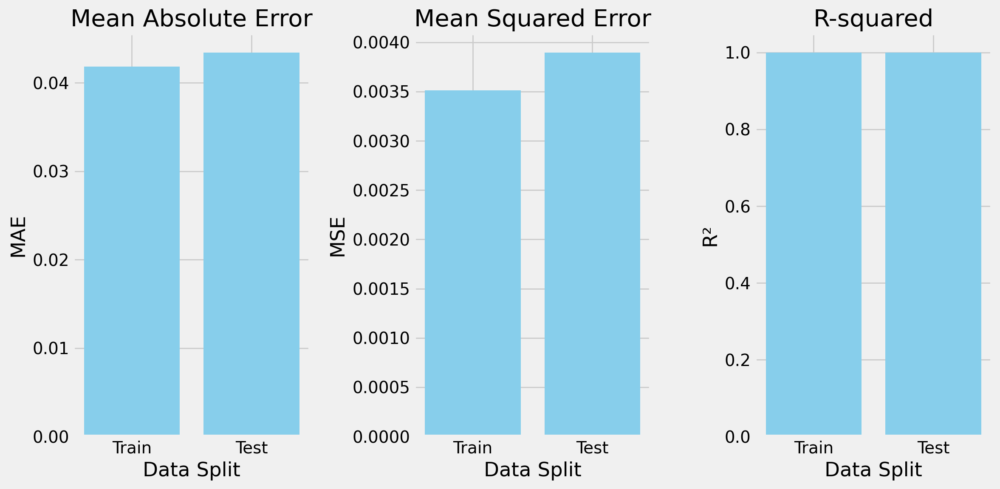

In [70]:
labels = ['Train', 'Test']
mae_values = [train_mae, test_mae]
mse_values = [train_mse, test_mse]
r2_values = [train_r2, test_r2]

x = range(len(labels))

plt.figure(figsize=(12, 6))

plt.subplot(1, 3, 1)
plt.bar(x, mae_values, color='skyblue')
plt.xticks(x, labels)
plt.xlabel('Data Split')
plt.ylabel('MAE')
plt.title('Mean Absolute Error')

plt.subplot(1, 3, 2)
plt.bar(x, mse_values, color='skyblue')
plt.xticks(x, labels)
plt.xlabel('Data Split')
plt.ylabel('MSE')
plt.title('Mean Squared Error')

plt.subplot(1, 3, 3)
plt.bar(x, r2_values, color='skyblue')
plt.xticks(x, labels)
plt.xlabel('Data Split')
plt.ylabel('R²')
plt.title('R-squared')

plt.tight_layout()
plt.show()

Shape of y_test after flattening: (485,)
     Actual   Predicted
0       180  180.000549
1        99   98.985764
2        90   90.011253
3       234  234.037354
4        90   90.011253
..      ...         ...
480     180  180.000549
481     234  234.037354
482     156  156.070190
483      99   98.985764
484     180  180.000549

[485 rows x 2 columns]


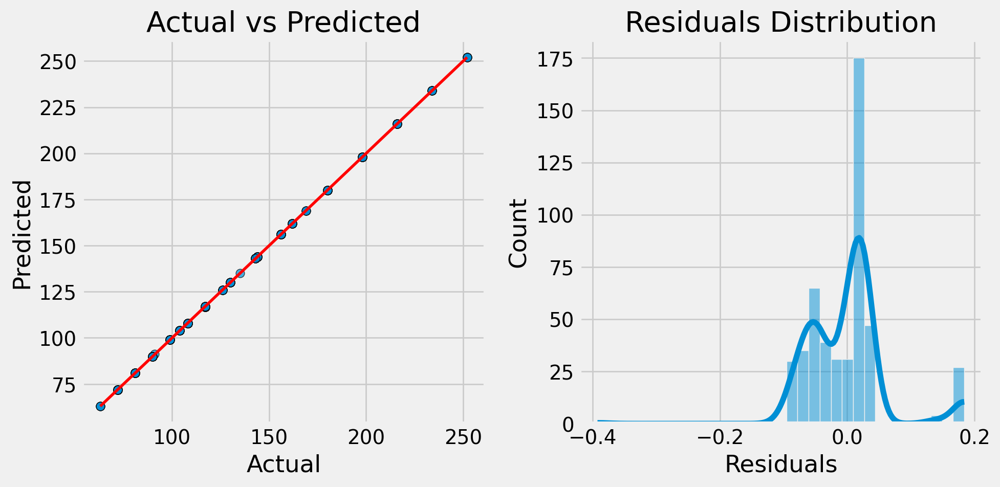

In [71]:
if isinstance(y_test, pd.DataFrame) or isinstance(y_test, pd.Series):
    y_test = y_test.to_numpy()  
    
if y_test.ndim > 1:
    y_test = y_test.ravel()  

print(f"Shape of y_test after flattening: {y_test.shape}")

results = pd.DataFrame({'Actual': y_test, 'Predicted': y_test_pred})

print(results)

plt.figure(figsize=(10, 5))

plt.subplot(1, 2, 1)
plt.scatter(y_test, y_test_pred, edgecolor='k', alpha=0.7)
plt.plot([min(y_test), max(y_test)], [min(y_test), max(y_test)], color='r', lw=2)
plt.xlabel('Actual')
plt.ylabel('Predicted')
plt.title('Actual vs Predicted')

plt.subplot(1, 2, 2)
residuals = y_test - y_test_pred
sns.histplot(residuals, kde=True)
plt.xlabel('Residuals')
plt.title('Residuals Distribution')

plt.tight_layout()
plt.show()

No artists with labels found to put in legend.  Note that artists whose label start with an underscore are ignored when legend() is called with no argument.


Average Actual Revenue: 130.99
Average Predicted Revenue: 130.99


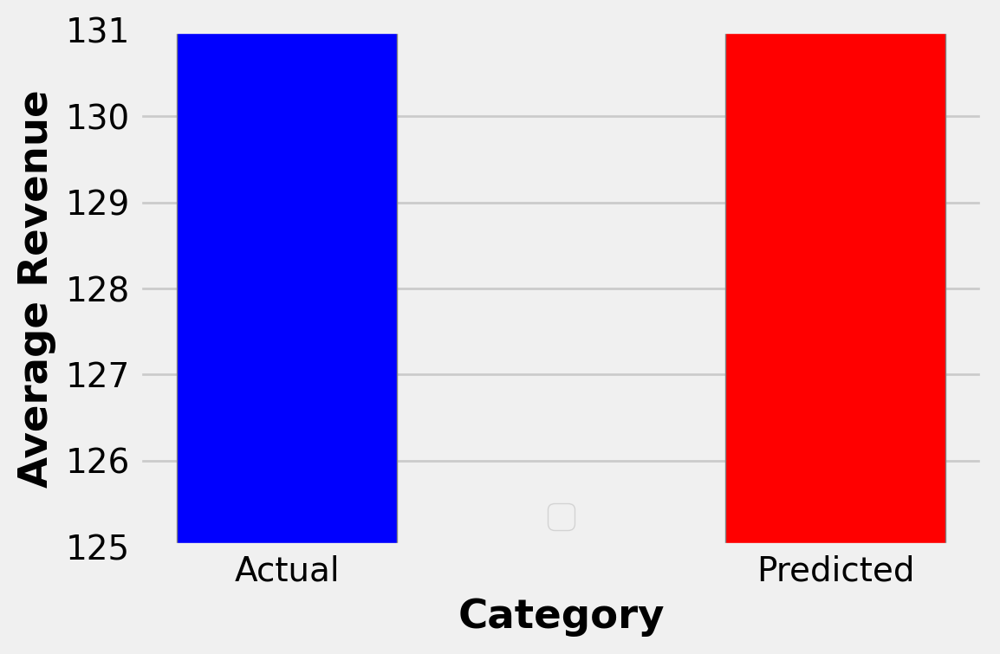

In [72]:
average_actual = results['Actual'].mean()
average_predicted = results['Predicted'].mean()

print(f"Average Actual Revenue: {average_actual:.2f}")
print(f"Average Predicted Revenue: {average_predicted:.2f}")

plt.figure(figsize=(6, 4))

bar_positions = np.arange(2)

plt.bar(bar_positions[0], average_actual, color='blue', width=0.4, edgecolor='grey')
plt.bar(bar_positions[1], average_predicted, color='red', width=0.4, edgecolor='grey')

plt.xlabel('Category', fontweight='bold')
plt.ylabel('Average Revenue', fontweight='bold')

plt.xticks(bar_positions, ['Actual', 'Predicted'])

plt.ylim(125, 131)

plt.legend()

plt.tight_layout()
plt.show()